## Run comments

<a href="https://confluence.desy.de/display/FLASH/2021+19+and+21+October+Beamtime" >Link to Confluence page</a>

### Essential cells

- [Setting the path to load and save the data](#loading)
- [Obtaining the spctrum of reference and streaked pulse](#spect)
- [Check spectral range](#check_spec)
- [Arrival time sorting](#arrival_t)
- [FWHM calculation - reference and streaked pulse](#fwhm_cal)
- [Pulse duration calculation - mean and std](#pulse_duration)
- [Correlation plots](#corr_plots)

### Extra cells

- [Finding the Best threshold for relative arrival time](#rel_arrival_t)
- [Ploting the fitting parameters](#fitting_param)
- [Ploting fitting curves](#fitting_curve)
- [Ploting traces](#trace)

In [1]:
import h5py
import scipy
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
from typing import List, Iterable, Optional, Dict, Union
from pandas import Series, DataFrame
import pandas as pd
from scipy.optimize import curve_fit
import glob
from scipy.signal import savgol_filter
from scipy import integrate
import matplotlib.gridspec as gridspec
from skimage.measure import block_reduce
from os import path as path_func
import os
from matplotlib.ticker import MaxNLocator
from PIL import Image, ImageDraw
import static_functions as sfun
from scipy.stats import gaussian_kde
import statistics

# Setting the global parameters for plottings 

plt.rcParams['font.size'] = 12
plt.rcParams['lines.linewidth'] = 2
plt.rcParams['ytick.major.pad'] = 0.5
plt.rcParams['xtick.major.pad'] = 2.5
plt.rcParams['ytick.right'] = True
plt.rcParams['xtick.top'] = True
plt.rcParams['ytick.direction'] = 'out'
plt.rcParams['xtick.direction'] = 'out'
plt.rcParams["figure.figsize"] = [10, 5]
#plt.rcParams["figure.figsize"] = plt.rcParamsDefault["figure.figsize"]
#plt.rcParams["figure.figsize"] = (6,10)

############## STREAKING SPEED [eV/fs] ############## this value must change from run to run

# streaking speed for 10 nm measurement - 19 Oct - taken from run 41454
str_slope_tof1 = 115.92/1000  
str_slope_tof2 = 87.01/1000

# streaking speed for 20 nm measurement - 19 Oct
#str_slope_tof1 = 46.53/1000  
#str_slope_tof2 = 46.17/1000

# streaking speed for 20 nm measurement - 19 Oct - taken from run 41445
#str_slope_tof1 = 148.16/1000  
#str_slope_tof2 = 122.96/1000

# streaking speed for 20 nm measurement - 21 Oct - taken from run 41572
#str_slope_tof1 = 51.05/1000  
#str_slope_tof2 = 47.23/1000


### Setting the path to __load__ and __save__ the data
<a id="loading"></a>

In [3]:
file_num = 1
run_number = 'run41465'
path =      '/asap3/flash/gpfs/fl21/2021/data/11013455/raw/hdf/FL2USER2/'
save_path = '/asap3/flash/gpfs/fl21/2021/data/11013455/processed/Analysis results/Static runs/'
file_path = sfun.get_path(run_number,path,file_num)

with h5py.File(file_path, 'r') as h5_file:
    adc_data1 = sfun.dset_data_frame(h5_file["FL2/Experiment/FL21/ADQ412 GHz ADC/CH00/TD"])   #address of the adc (tof data)
    adc_data2 = sfun.dset_data_frame(h5_file["FL2/Experiment/FL21/ADQ412 GHz ADC/CH02/TD"])
    laser_delay_data = sfun.dset_data_frame(h5_file["FL2/Experiment/FL21/Laser/streaking delayline pos"])
    #retardation_voltage_data = sfun.dset_data_frame(h5_file["FL2/Experiment/FL21/TOF/retardation voltage readback 1"])
    retardation_voltage_data = sfun.dset_data_frame(h5_file["/uncategorised/FLASH.FEL/FL21.VACUUM/BEAMLINE/OPCUA.PRG_Beamline.fbTOF1.fRetVoltV"])
    sample_frequency_data1 = sfun.dset_data_frame(h5_file["FL2/Experiment/FL21/ADQ412 GHz ADC/CH00/sample frequency"])
    sample_frequency_data2 = sfun.dset_data_frame(h5_file["FL2/Experiment/FL21/ADQ412 GHz ADC/CH02/sample frequency"])
    #polarix_data = sfun.dset_data_frame(h5_file["/uncategorised/FLASH.DIAG/CAMERA/OTR9FL2XTDS"])
    gmd_hall = sfun.dset_data_frame(h5_file["/FL2/Photon Diagnostic/GMD/Pulse resolved energy/energy hall"])
    gmd_tunnel = sfun.dset_data_frame(h5_file["/FL2/Photon Diagnostic/GMD/Pulse resolved energy/energy tunnel"])
# the path in which the outputs are saved:
try:
    os.mkdir(save_path + run_number +f'_file{file_num}/')
except OSError:
    pass
os.chdir(save_path + run_number +f'_file{file_num}/')

### Obtaining the __spctrum__ of reference and streaked pulse
<a id="spect"></a>

In [4]:
energy_calibration_parameters=([ 1.99774128e+05, -9.98000000e+02,  4.50000000e+01])
distance = 3590 #this number shouldn't be changed, it is the fixed distance of the reference and streaked pulse
sample_str_min = 3800  # min sample number of the streaked trace
sample_ref_min = sample_str_min + distance # min sample number of the reference trace (next bunch)
width=400 #the width of the range for the ref and str pulse
sample_str_max = sample_str_min + width
sample_ref_max = sample_ref_min + width

reference_signal, streaked_signal, energy_data, no_bck, s_rate = sfun.stat_str(
    adc_data1,laser_delay_data,retardation_voltage_data,sample_frequency_data1,'_tof1_',sample_str_min,sample_ref_min,width,energy_calibration_parameters)
reference_signal2, streaked_signal2, energy_data2, no_bck2, s_rate2 = sfun.stat_str(
    adc_data2,laser_delay_data,retardation_voltage_data,sample_frequency_data2,'_tof2_',sample_str_min,sample_ref_min,width,energy_calibration_parameters)

energy_axis = energy_data[sample_str_min:sample_str_max]
energy_axis2 = energy_data2[sample_str_min:sample_str_max]

last_shot = len(adc_data1) # this line is to remove the last shots in which the shutter is closed
#last_shot = 2100 
first_shot = 0
#last_shot = 700 #defualt value is len(adc_data1)
reference_signal = reference_signal[:,first_shot:last_shot]
streaked_signal = streaked_signal[:,first_shot:last_shot]
reference_signal2 = reference_signal2[:,first_shot:last_shot]
streaked_signal2 = streaked_signal2[:,first_shot:last_shot]

### Check spectral range
<a id="check_spec"></a>

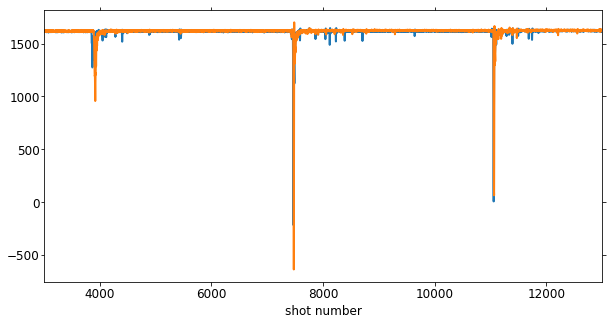

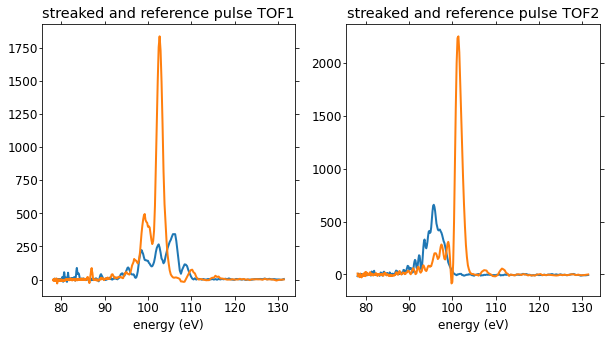

In [5]:
s_min = 0    # min sample number of the adc
s_max = 15000   # max sample number of the adc
shot_num = 62 # it's a random shot to only see if the range is correct

# this line is to get the right range for the first FEL pulse recorded by TOF1 and TOF2
raww = sfun.data2matrixarray(adc_data1.to_numpy(), s_min, s_max)
raww2 = sfun.data2matrixarray(adc_data2.to_numpy(), s_min, s_max)

plt.plot(raww[shot_num])
plt.plot(raww2[shot_num])
plt.xlim(3000,13000)
plt.xlabel("shot number")
plt.show()

plt.subplot(1, 2, 1)
plt.plot(energy_axis,streaked_signal[:,shot_num])  #str spectrum TOF1 in energy domain
plt.plot(energy_axis,reference_signal[:,shot_num])
plt.title("streaked and reference pulse TOF1")
plt.xlabel('energy (eV)')

plt.subplot(1, 2, 2)
plt.plot(energy_axis2,streaked_signal2[:,shot_num])  #str spectrum TOF2 in energy domain
plt.plot(energy_axis2,reference_signal2[:,shot_num])
plt.title("streaked and reference pulse TOF2")
plt.xlabel('energy (eV)')
plt.show()

### Arrival time sorting
<a id="arrival_t"></a>

maximum relative arrival time: 40
total number:               772
number of temporal inliers: 760


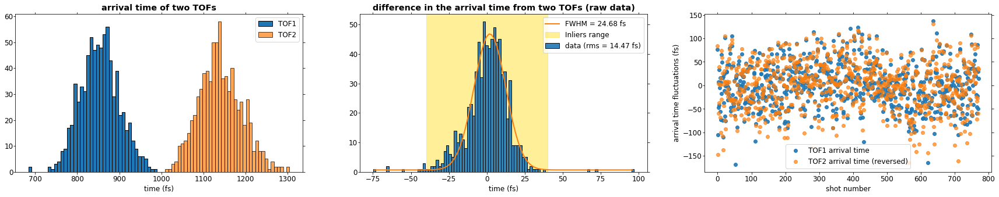

In [6]:
# this cell is to sort out the spectra with big difference in arrival times

max_rel_arrival_time = 40 
print("maximum relative arrival time:",max_rel_arrival_time)
cg1,cg2,difference,temporal_inliers,cg1_fluc,cg2_fluc,reversed_cg2,difference = sfun.temporal_sorter(sample_str_min , sample_str_max , width , no_bck[:,first_shot:last_shot] , no_bck2[:,first_shot:last_shot] , max_rel_arrival_time , energy_axis , str_slope_tof1 , str_slope_tof2)
arrival_res = np.std(difference)

#### PLOTS ####
plt.rcParams["figure.figsize"] = [30,5]
plt.subplot(1,3,1)
plt.hist(cg1 , bins=40 ,edgecolor='k',label='TOF1')
plt.hist(cg2 , bins=40 ,edgecolor='k', alpha=0.7,label='TOF2')
plt.title("arrival time of two TOFs", fontweight='bold')
plt.xlabel('time (fs)')
plt.legend()

plt.subplot(1,3,2)
plt.axvspan(-max_rel_arrival_time,max_rel_arrival_time,color ='gold', alpha=0.4,label='Inliers range')
bin_heights, bin_borders, _ = plt.hist(difference , bins=100 ,edgecolor='k', alpha=0.9 , label='data (rms = %s fs)'%round(arrival_res,2))
plt.title("difference in the arrival time from two TOFs (raw data)", fontweight='bold')
plt.xlabel('time (fs)')
bin_centers = bin_borders[:-1] + np.diff(bin_borders) / 2
[H_hist, A_hist, x0_hist, sigma_hist], _ = sfun.gauss_fit(bin_centers, bin_heights, np.max(bin_heights), bin_centers[np.argmax(bin_heights)], 2)
plt.plot(bin_centers,sfun.gauss(bin_centers, H_hist, A_hist, x0_hist, sigma_hist), label='FWHM = %s fs'%round(sigma_hist*2.3548,2))
plt.legend()

plt.subplot(1,3,3)
plt.plot(cg1_fluc,"o",label="TOF1 arrival time",alpha=0.9)
plt.plot(reversed_cg2,"o",label="TOF2 arrival time (reversed)",alpha=0.7)
plt.xlabel("shot number")
plt.ylabel("arrival time fluctuations (fs)")
plt.legend()

#plt.savefig(f"{run_number}_arrival_time.png",dpi=300)
plt.show()
plt.rcParams["figure.figsize"] = [10, 5]

### __FWHM calculation__ - reference and streaked pulse
<a id="fwhm_cal"></a>

ref mean - TOF1: 102.47505361187036
str mean - TOF1: 100.20643070226026
ref mean - TOF2: 101.62032473632705
str mean - TOF2: 98.88864696106467


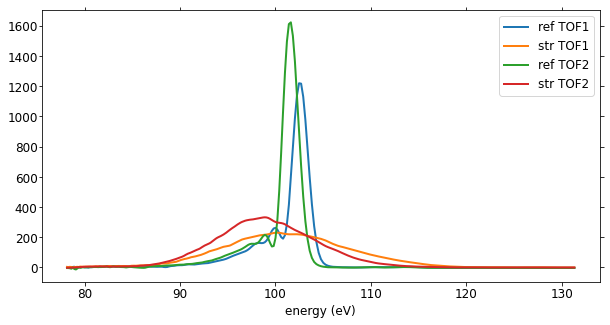

total number of shots:                        772
number of fitting inliers - TOF1:             660
number of fitting inliers - TOF2:             760
number of total fitting inliers:              656
number of total fitting and temporal inliers: 653


In [7]:
#calculation of the mean value for the averaged spectrum:
mean_ref1, mean_str1, amp_ref1, amp_str1 = sfun.mean_calculator(energy_axis,reference_signal,streaked_signal,1)
mean_ref2, mean_str2, amp_ref2, amp_str2 = sfun.mean_calculator(energy_axis2,reference_signal2,streaked_signal2,2)
plt.savefig(f"{run_number}_averaged_spectrum.png")
plt.show()

#sorting out the fitting outliers:
amplitude_ref1,amplitude_str1,base_ref1,base_str1,sigma_ref_list1,sigma_str_list1,x0_ref_list1,x0_str_list1,err_ref1,err_str1,fit_integ_ref1,fit_integ_str1,fitting_inliers_TOF1 = sfun.fitting_sorter(
    energy_axis,reference_signal,streaked_signal,amp_ref1,amp_str1,mean_ref1,mean_str1)
amplitude_ref2,amplitude_str2,base_ref2,base_str2,sigma_ref_list2,sigma_str_list2,x0_ref_list2,x0_str_list2,err_ref2,err_str2,fit_integ_ref2,fit_integ_str2,fitting_inliers_TOF2 = sfun.fitting_sorter(
    energy_axis2,reference_signal2,streaked_signal2,amp_ref2,amp_str2,mean_ref2,mean_str2)

fitting_inliers = np.multiply(fitting_inliers_TOF1,fitting_inliers_TOF2)
inliers_index = np.multiply(temporal_inliers,fitting_inliers)

########################################################################### To make a list of parameters from inlier pulses
sigma_ref_list_inlier1,amplitude_ref_inlier1,base_ref_list_inlier1,err_ref_list_inlier1,fit_integ_ref_inlier1,x0_ref_list_inlier1,cg1_inlier = [],[],[],[],[],[],[]
sigma_str_list_inlier1,amplitude_str_inlier1,base_str_list_inlier1,err_str_list_inlier1,fit_integ_str_inlier1,x0_str_list_inlier1 = [],[],[],[],[],[]
sigma_ref_list_inlier2,amplitude_ref_inlier2,base_ref_list_inlier2,err_ref_list_inlier2,fit_integ_ref_inlier2,x0_ref_list_inlier2,cg2_inlier = [],[],[],[],[],[],[]
sigma_str_list_inlier2,amplitude_str_inlier2,base_str_list_inlier2,err_str_list_inlier2,fit_integ_str_inlier2,x0_str_list_inlier2 = [],[],[],[],[],[]

for i in range(0,len(inliers_index)):
    if inliers_index[i]>0:
        sigma_ref_list_inlier1.append(sigma_ref_list1[i]),sigma_str_list_inlier1.append(sigma_str_list1[i]),amplitude_ref_inlier1.append(amplitude_ref1[i]),amplitude_str_inlier1.append(amplitude_str1[i])
        sigma_ref_list_inlier2.append(sigma_ref_list2[i]),sigma_str_list_inlier2.append(sigma_str_list2[i]),amplitude_ref_inlier2.append(amplitude_ref2[i]),amplitude_str_inlier2.append(amplitude_str2[i])
        fit_integ_ref_inlier1.append(fit_integ_ref1[i]), fit_integ_str_inlier1.append(fit_integ_str1[i]),base_ref_list_inlier1.append(base_ref1[i]),base_str_list_inlier1.append(base_str1[i])
        fit_integ_ref_inlier2.append(fit_integ_ref2[i]),fit_integ_str_inlier2.append(fit_integ_str2[i]),base_ref_list_inlier2.append(base_ref2[i]),base_str_list_inlier2.append(base_str2[i])
        err_ref_list_inlier1.append(err_ref1[i]),err_str_list_inlier1.append(err_str1[i]),cg1_inlier.append(cg1[i])
        err_ref_list_inlier2.append(err_ref2[i]),err_str_list_inlier2.append(err_str2[i]),cg2_inlier.append(cg2[i])
###########################################################################

print("total number of shots:                       ",len(reference_signal[1,:]))
print("number of fitting inliers - TOF1:            ",np.sum(fitting_inliers_TOF1))
print("number of fitting inliers - TOF2:            ",np.sum(fitting_inliers_TOF2))
print("number of total fitting inliers:             ",np.sum(fitting_inliers))
print("number of total fitting and temporal inliers:",np.sum(inliers_index))

### __Pulse duration calculation__ (Change the streaking speed)
<a id="pulse_duration"></a>

In [8]:
t_tof1,t_tof2,t_tof1_inlier,t_tof2_inlier = sfun.duration_calculator(
    run_number,inliers_index,sigma_str_list1,sigma_str_list2,sigma_ref_list1,sigma_ref_list2,str_slope_tof1,str_slope_tof2,arrival_res) 

Run number: run41465
Number of all shots:            772
Average pulse duration - TOF 1: 57 ± 18
Average pulse duration - TOF 2: 43 ± 10
Uncertainty - TOF 1:            31 % 
Uncertainty - TOF 2 :           23 % 
-------------------------------------
Number of inlier shots:         653
Average pulse duration - TOF 1: 56 ± 17
Average pulse duration - TOF 2: 42 ± 10
Uncertainty - TOF 1:            31 % 
Uncertainty - TOF 2:            24 % 
-------------------------------------
Arrival time resolution (rms):  14 fs


### Plots
<a id="corr_plots"></a>

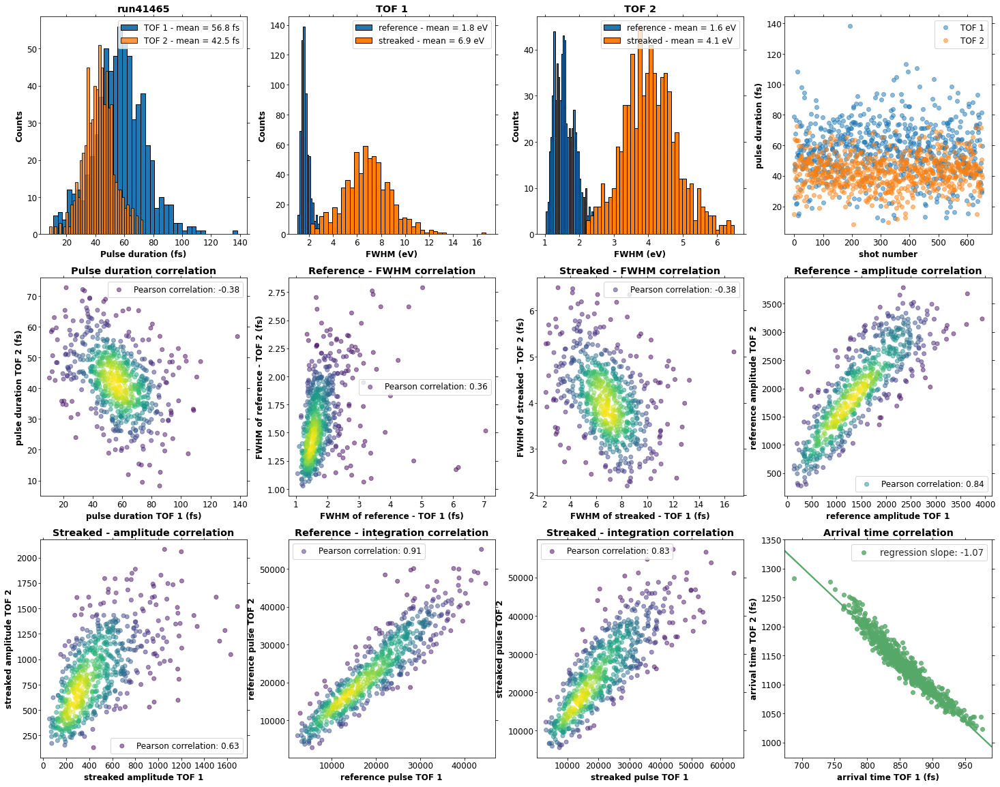

In [9]:
plt.rcParams["figure.figsize"] = (25,20)

sfun.correlation_plotter(t_tof1_inlier,t_tof2_inlier,sigma_ref_list_inlier1,sigma_str_list_inlier1,sigma_ref_list_inlier2,sigma_str_list_inlier2,
                         amplitude_ref_inlier1,amplitude_ref_inlier2,amplitude_str_inlier1,amplitude_str_inlier2,fit_integ_ref_inlier1,fit_integ_ref_inlier2,fit_integ_str_inlier1,fit_integ_str_inlier2,cg1_inlier,cg2_inlier,str_slope_tof1,str_slope_tof2,run_number)   
#plt.savefig(f"{run_number}_correlation_plots.png",dpi=300)
plt.show()
plt.rcParams["figure.figsize"] = [10, 5]

### Extra cells
### Finding the Best __threshold__ for __relative arrival time__
<a id="rel_arrival_t"></a>

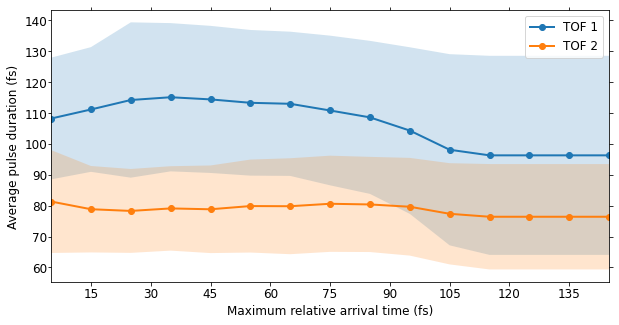

In [36]:
# in this cell I change the max value for the relative arrival time and calculate the pulse duration

min_rel_arrival = 5
max_rel_arrival = 150

rel_arrival,t_tof1_list,t_tof2_list,t_tof1_err,t_tof2_err = sfun.rel_arrival_time(
    min_rel_arrival,max_rel_arrival,energy_axis,energy_axis2,no_bck,no_bck2,str_slope_tof1,str_slope_tof2,reference_signal,reference_signal2,streaked_signal,streaked_signal2)

fig, ax = plt.subplots()
plt.plot(rel_arrival, t_tof1_list,'-o',label="TOF 1")
plt.plot(rel_arrival, t_tof2_list,'-o',label="TOF 2")
plt.fill_between(rel_arrival, np.add(t_tof1_list,t_tof1_err),np.subtract(t_tof1_list,t_tof1_err), alpha=0.2)
plt.fill_between(rel_arrival, np.add(t_tof2_list,t_tof2_err),np.subtract(t_tof2_list,t_tof2_err), alpha=0.2)
ax.set_xlabel('Maximum relative arrival time (fs)')
ax.set_ylabel('Average pulse duration (fs)')
ax.xaxis.set_major_locator(MaxNLocator(11)) 
ax.legend()
plt.xlim(np.min(rel_arrival),np.max(rel_arrival))
plt.savefig(f"{run_number}_max_arrival_time_raw.png")
plt.show()


### Ploting the __fitting parameters__
<a id="fitting_param"></a>

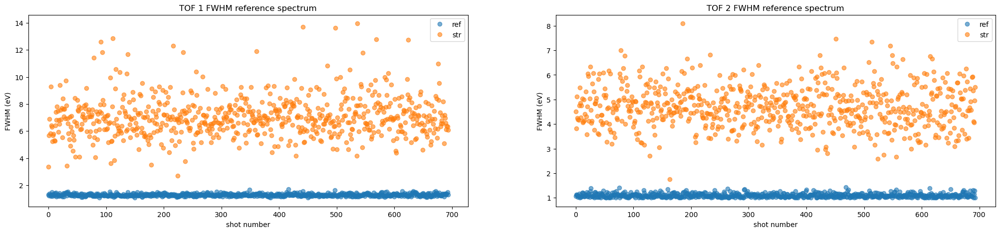

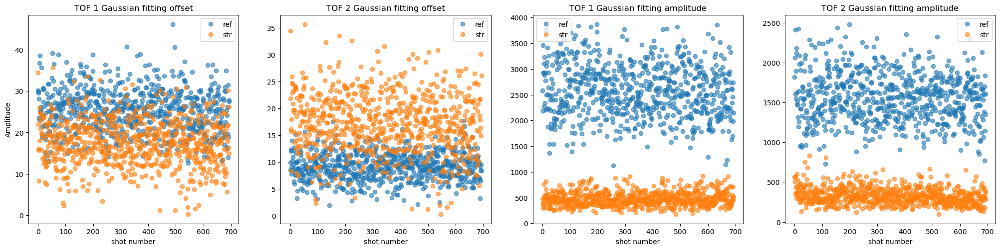

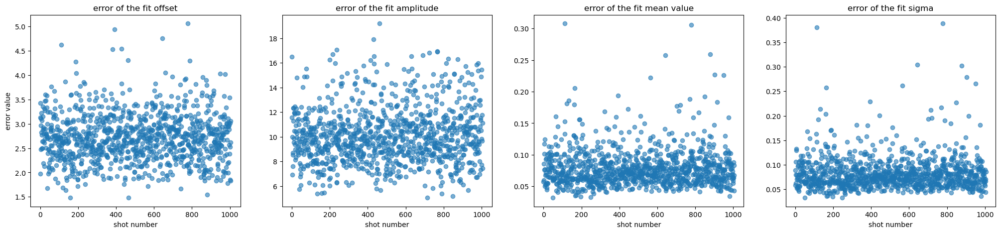

In [20]:
plt.rcParams["figure.figsize"] = (25,5)
sfun.fwhm_plotter(sigma_ref_list_inlier1,sigma_ref_list_inlier2,sigma_str_list_inlier1,sigma_str_list_inlier2)
plt.rcParams["figure.figsize"] = (25,12)    
sfun.gaussian_amp_base_plotter(base_ref_list_inlier1,base_ref_list_inlier2,base_str_list_inlier1,base_str_list_inlier1,amplitude_ref_inlier1,amplitude_ref_inlier2,amplitude_str_inlier1,amplitude_str_inlier2)
plt.rcParams["figure.figsize"] = (25,5) 
sfun.error_plotter(err_str1) #err_ref1 err_ref2 err_str2 can be plotted as well
plt.rcParams["figure.figsize"] = [10, 5]

### Ploting __fitting curves__
<a id="fitting_curve"></a>

inlier index: 0


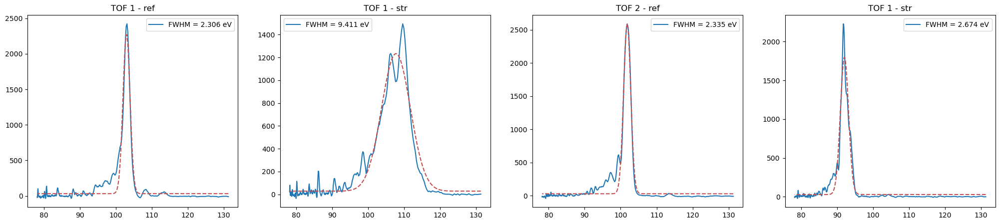

------------------------------------------------------------------------------
inlier index: 2


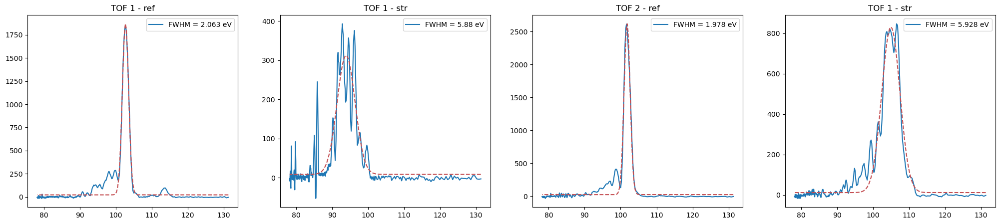

------------------------------------------------------------------------------
inlier index: 3


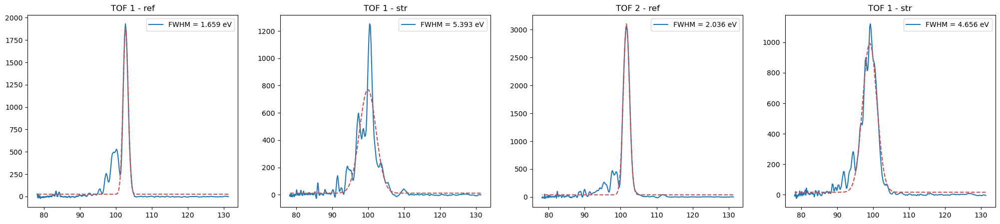

------------------------------------------------------------------------------
inlier index: 4


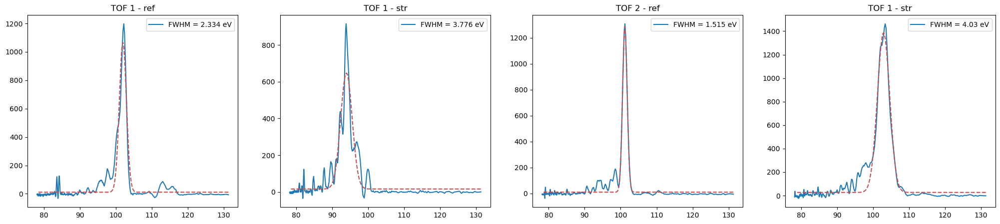

------------------------------------------------------------------------------
inlier index: 5


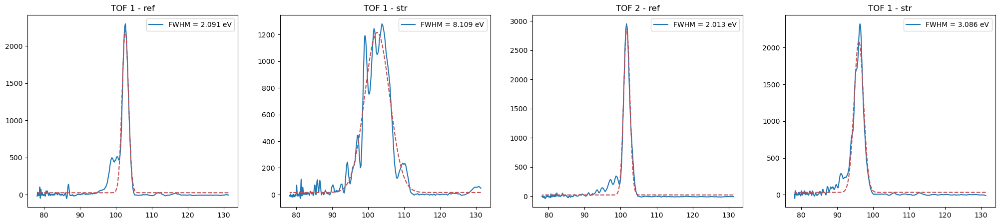

------------------------------------------------------------------------------
inlier index: 6


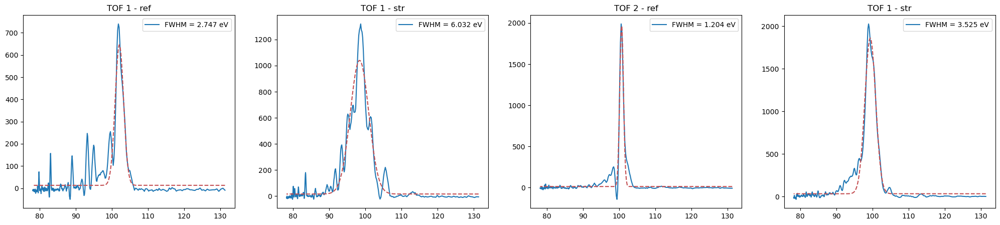

------------------------------------------------------------------------------
inlier index: 7


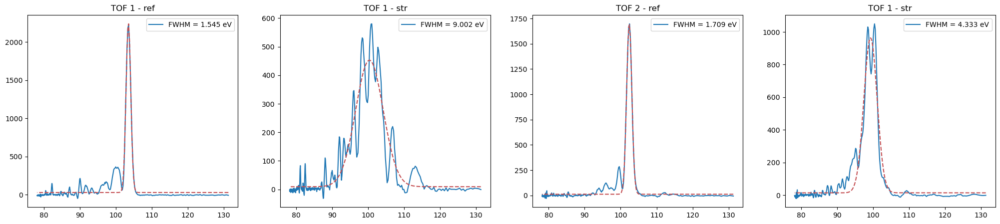

------------------------------------------------------------------------------
inlier index: 8


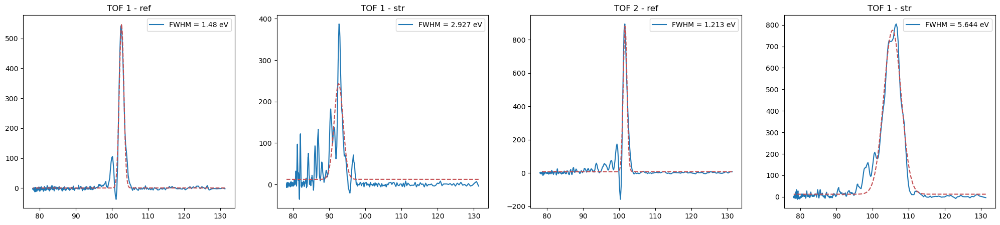

------------------------------------------------------------------------------
inlier index: 9


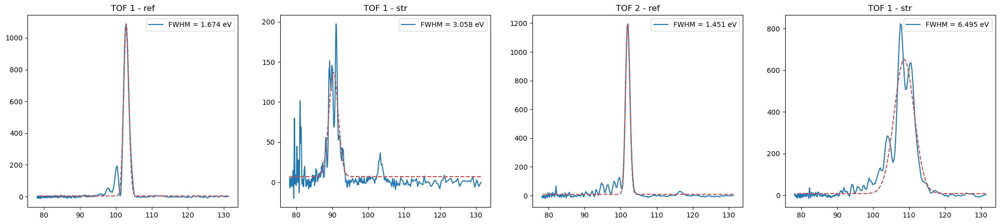

------------------------------------------------------------------------------
inlier index: 10


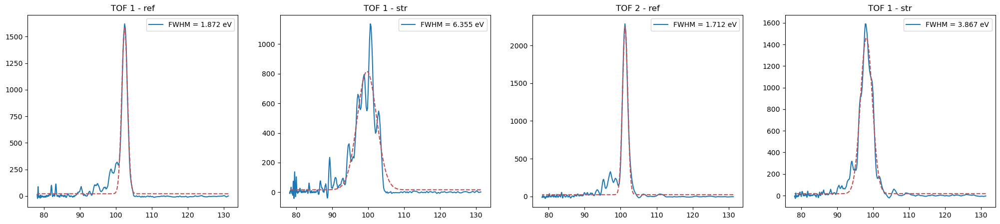

------------------------------------------------------------------------------
inlier index: 11


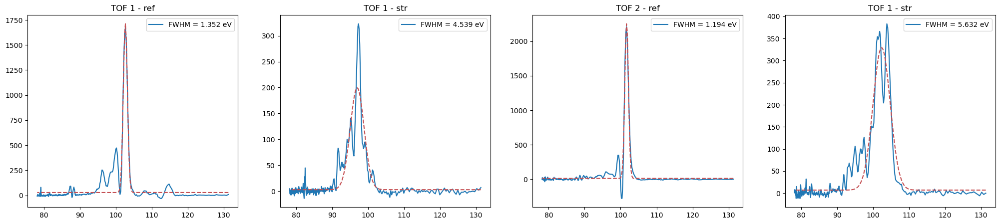

------------------------------------------------------------------------------
inlier index: 12


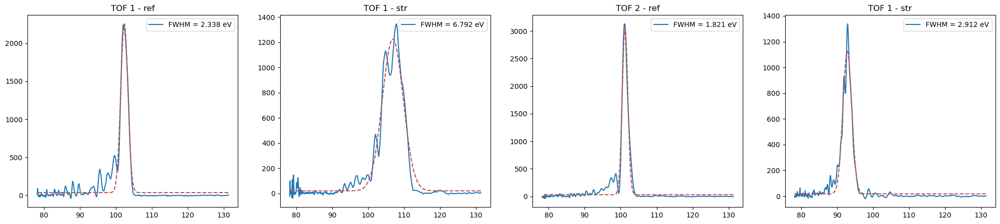

------------------------------------------------------------------------------
inlier index: 13


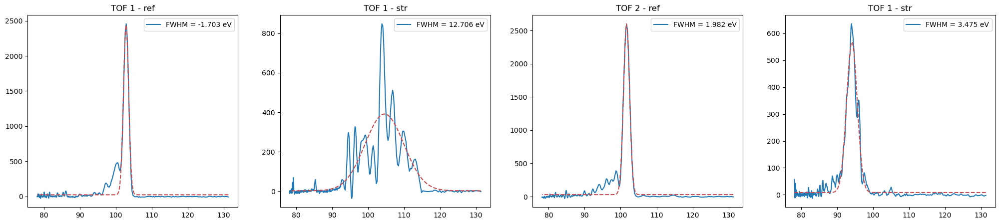

------------------------------------------------------------------------------
inlier index: 14


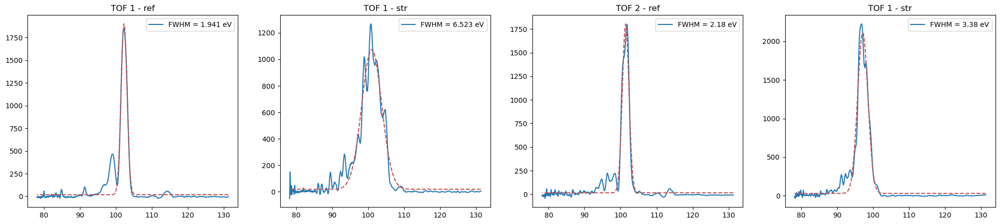

------------------------------------------------------------------------------
inlier index: 15


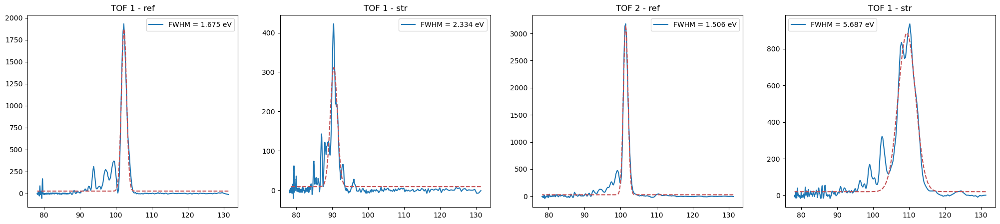

------------------------------------------------------------------------------
inlier index: 16


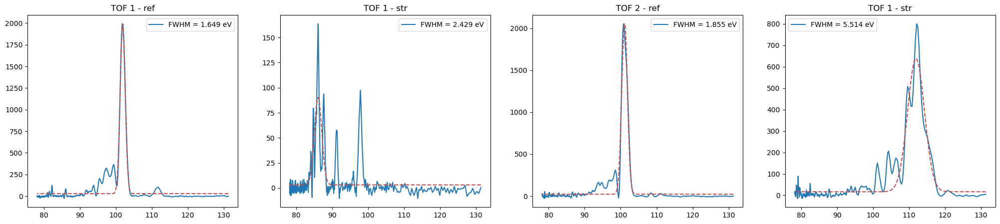

------------------------------------------------------------------------------
inlier index: 17


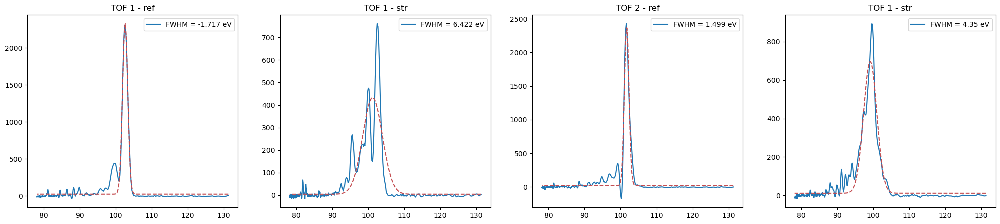

------------------------------------------------------------------------------
inlier index: 18


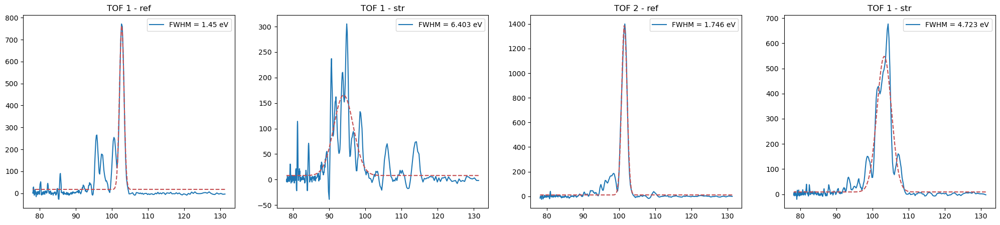

------------------------------------------------------------------------------
inlier index: 19


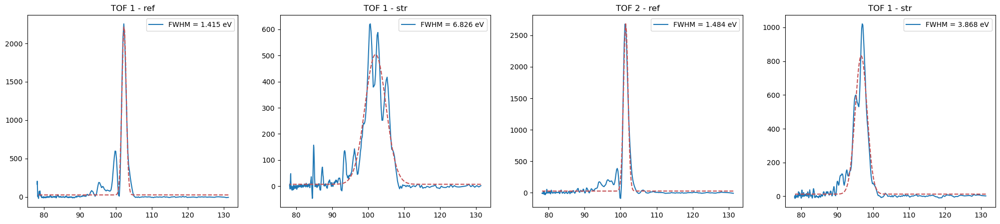

------------------------------------------------------------------------------
inlier index: 20


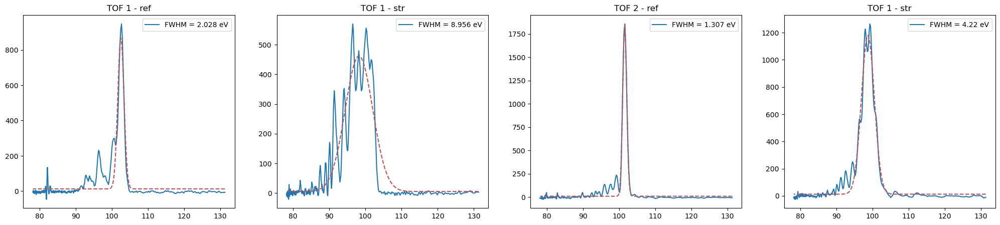

------------------------------------------------------------------------------
inlier index: 21


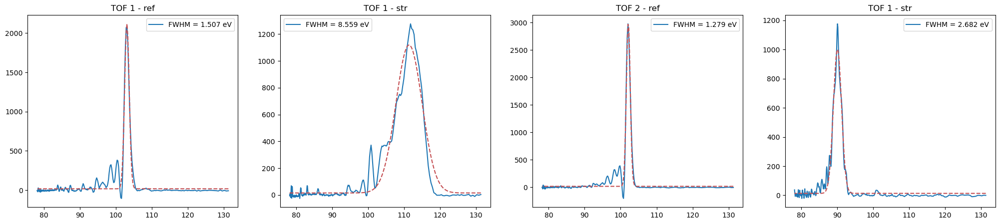

------------------------------------------------------------------------------
inlier index: 22


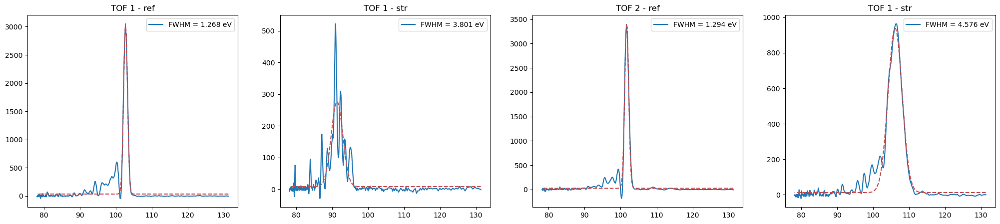

------------------------------------------------------------------------------
inlier index: 23


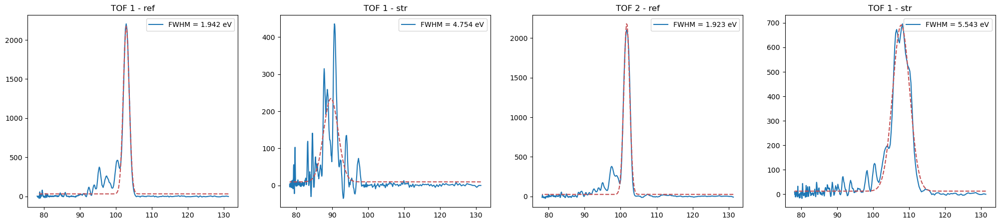

------------------------------------------------------------------------------
inlier index: 24


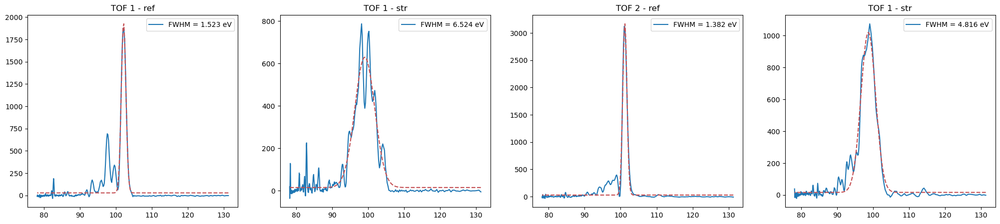

------------------------------------------------------------------------------
inlier index: 25


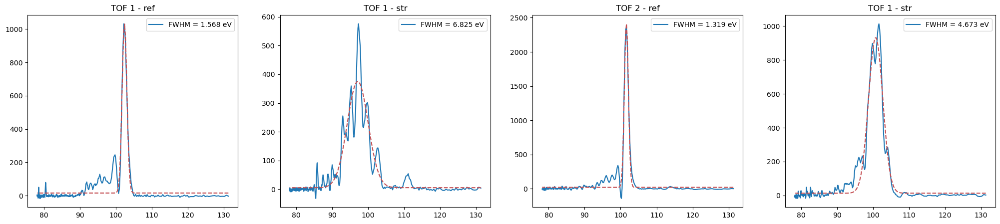

------------------------------------------------------------------------------
inlier index: 26


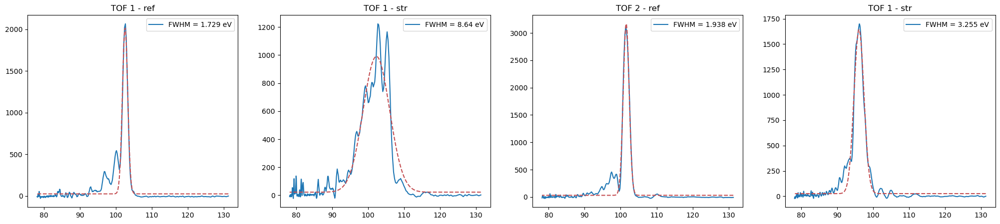

------------------------------------------------------------------------------
inlier index: 27


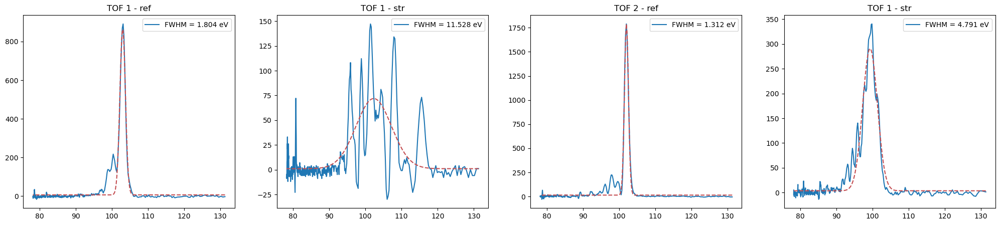

------------------------------------------------------------------------------
inlier index: 28


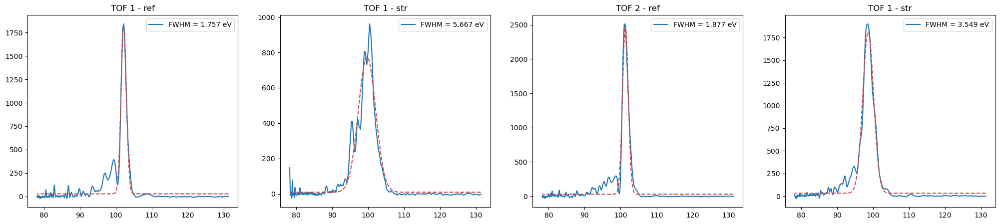

------------------------------------------------------------------------------
inlier index: 29


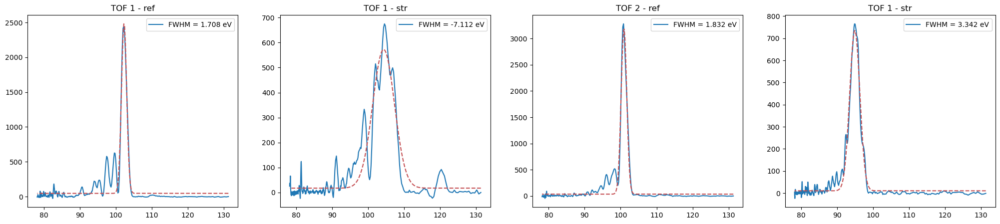

------------------------------------------------------------------------------
inlier index: 30


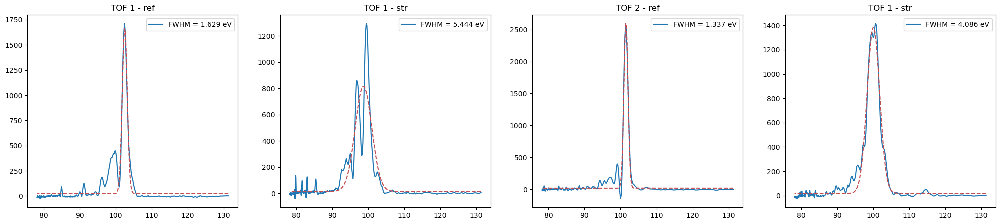

------------------------------------------------------------------------------
inlier index: 31


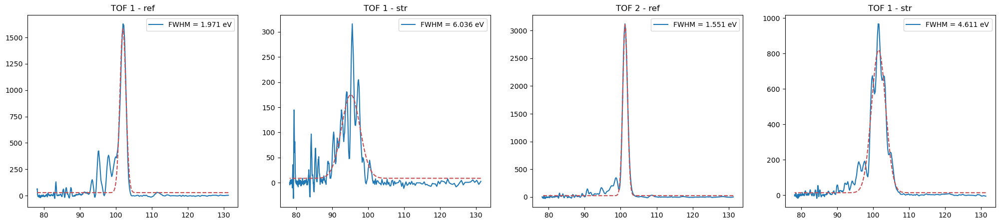

------------------------------------------------------------------------------
inlier index: 32


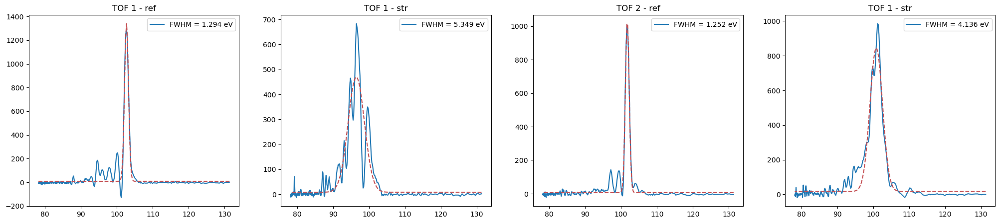

------------------------------------------------------------------------------
inlier index: 33


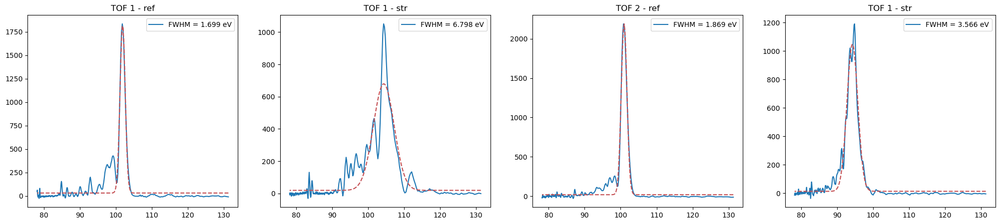

------------------------------------------------------------------------------
inlier index: 34


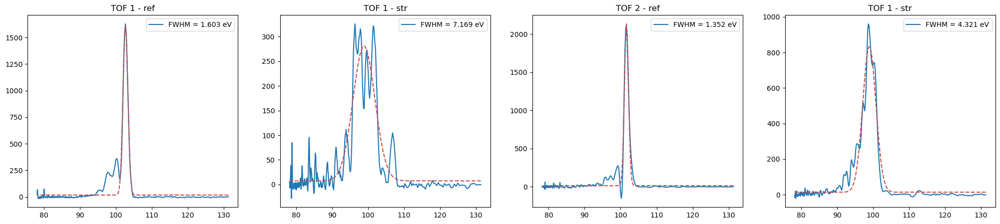

------------------------------------------------------------------------------
inlier index: 35


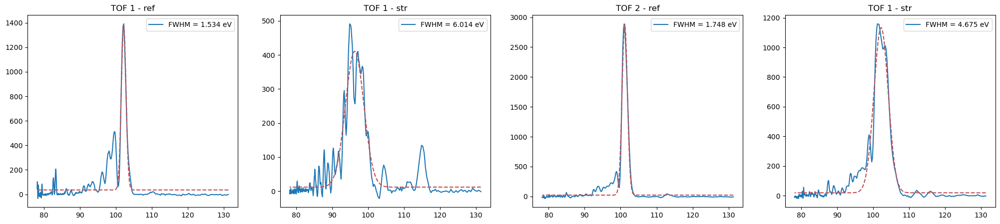

------------------------------------------------------------------------------
inlier index: 36


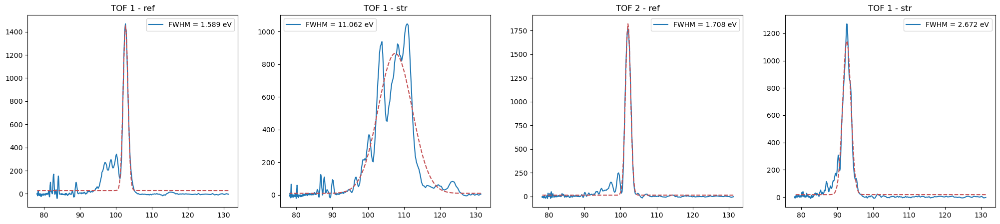

------------------------------------------------------------------------------
inlier index: 37


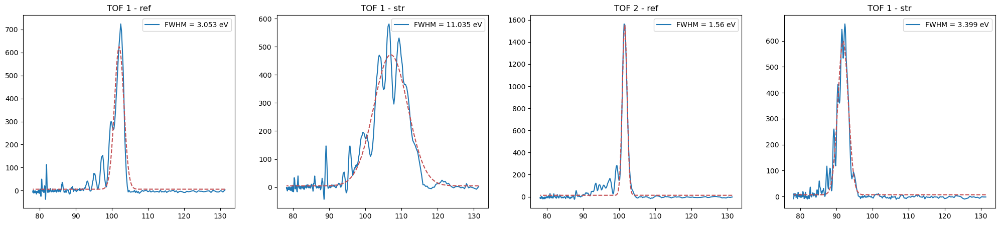

------------------------------------------------------------------------------
inlier index: 38


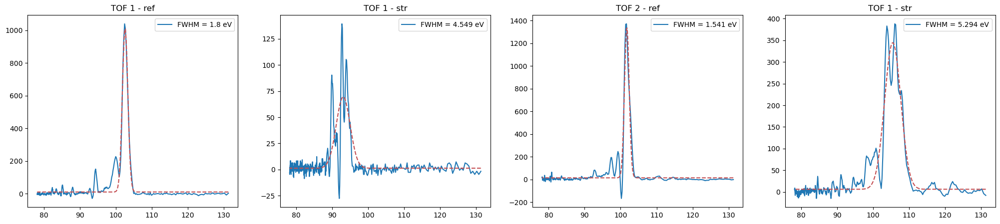

------------------------------------------------------------------------------
inlier index: 39


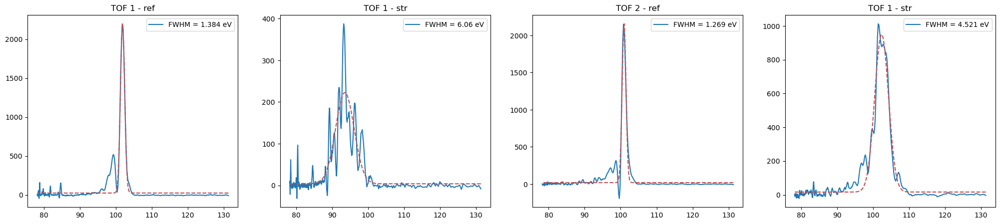

------------------------------------------------------------------------------
inlier index: 40


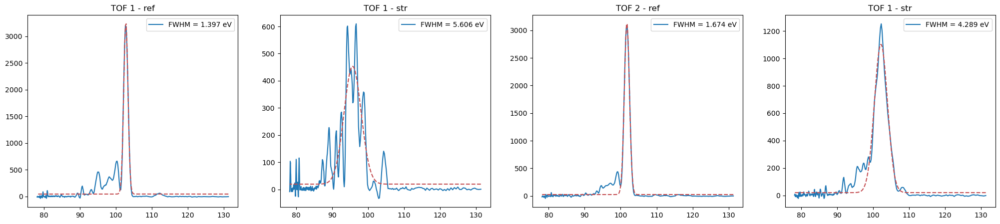

------------------------------------------------------------------------------
inlier index: 41


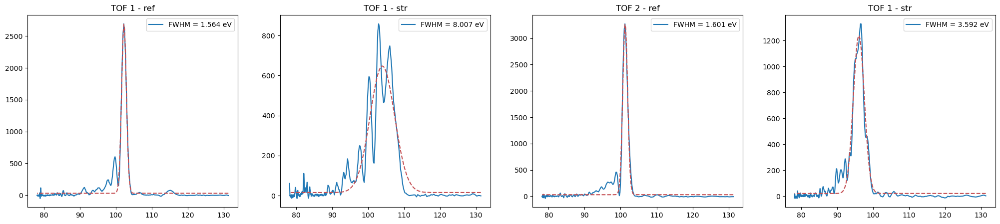

------------------------------------------------------------------------------
inlier index: 42


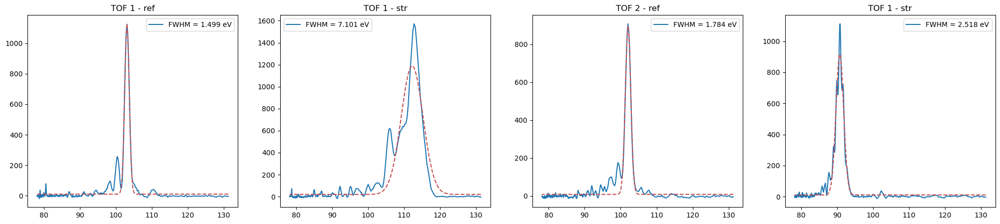

------------------------------------------------------------------------------
inlier index: 44


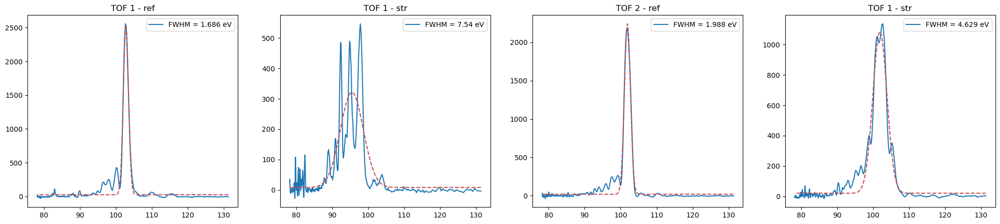

------------------------------------------------------------------------------
inlier index: 45


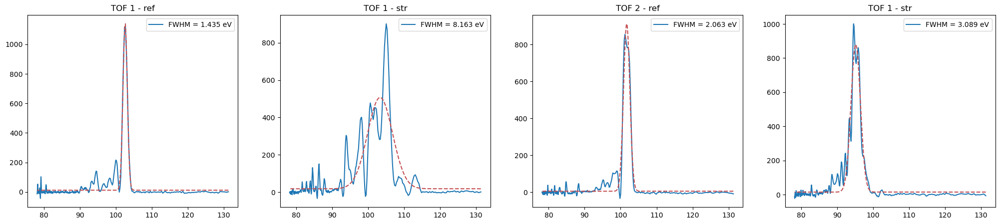

------------------------------------------------------------------------------
inlier index: 46


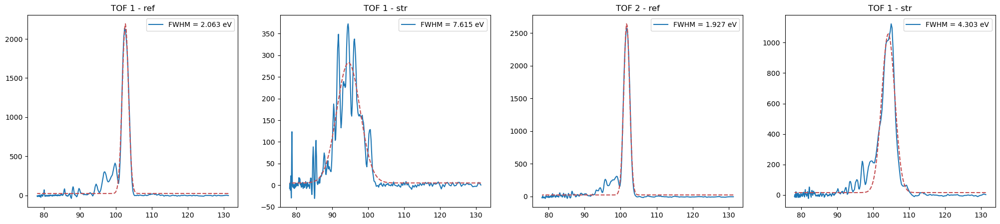

------------------------------------------------------------------------------
inlier index: 47


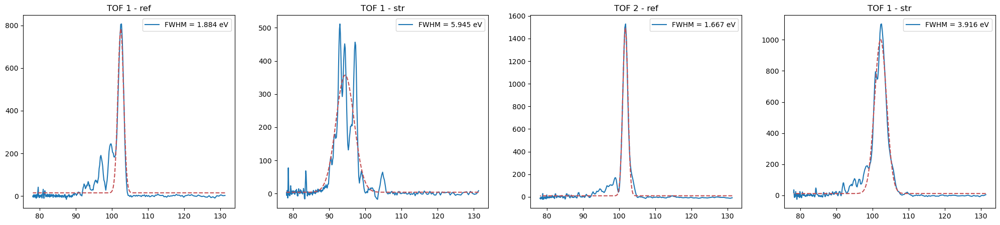

------------------------------------------------------------------------------
inlier index: 48


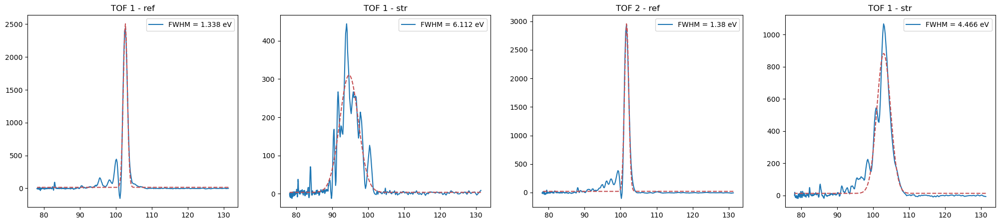

------------------------------------------------------------------------------
inlier index: 49


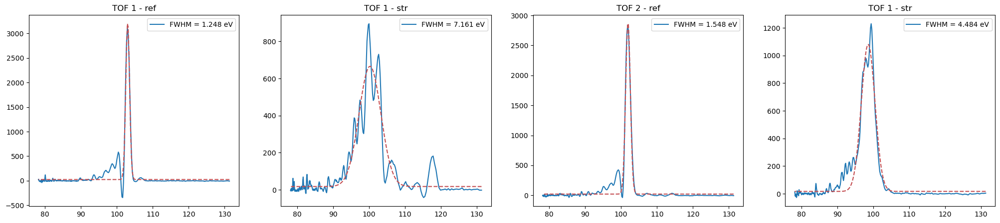

------------------------------------------------------------------------------
inlier index: 50


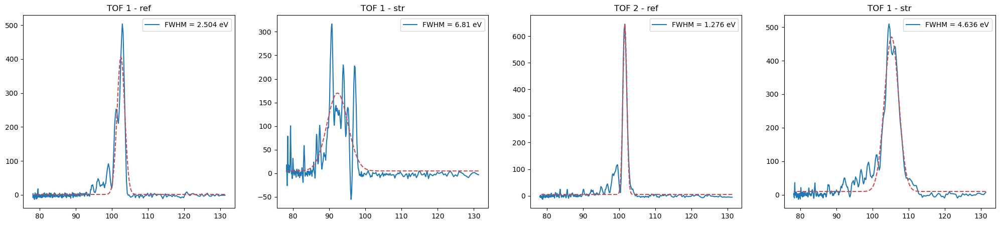

------------------------------------------------------------------------------
inlier index: 51


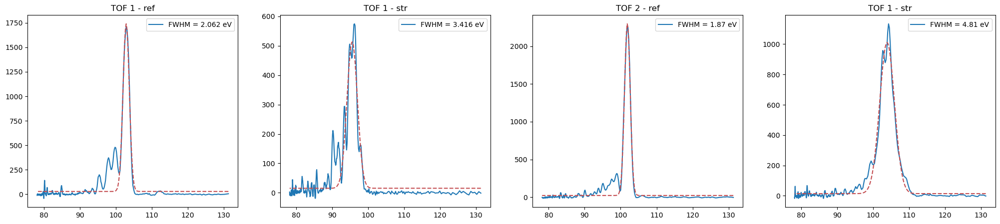

------------------------------------------------------------------------------
inlier index: 53


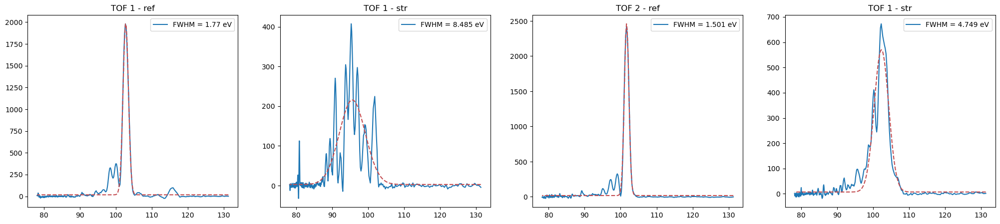

------------------------------------------------------------------------------
inlier index: 54


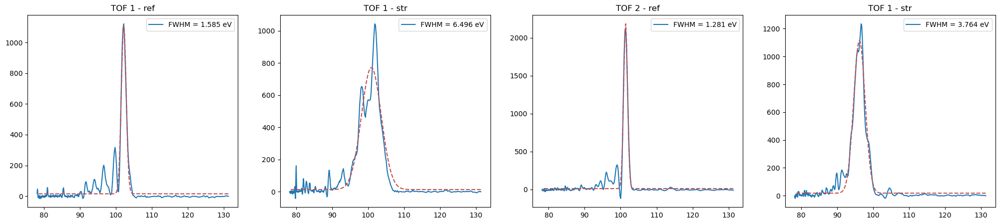

------------------------------------------------------------------------------
inlier index: 55


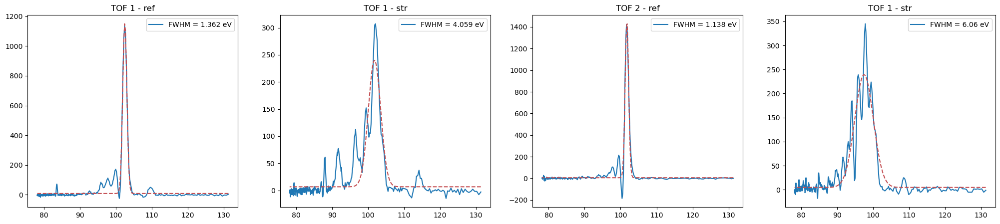

------------------------------------------------------------------------------
inlier index: 56


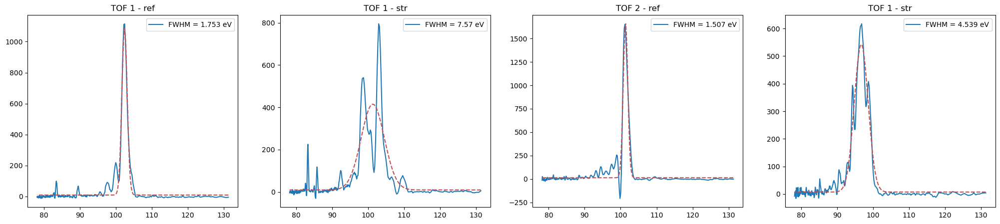

------------------------------------------------------------------------------
inlier index: 57


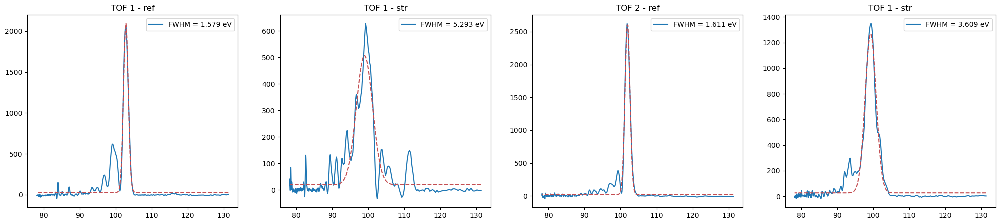

------------------------------------------------------------------------------
inlier index: 58


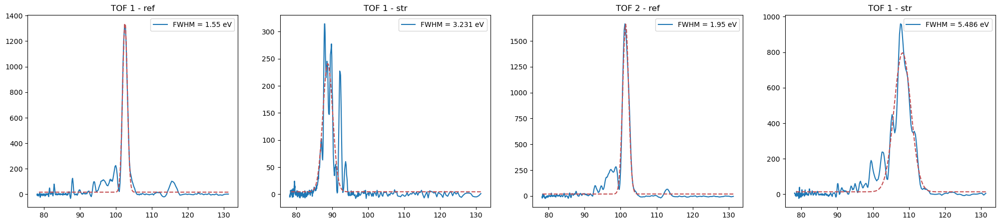

------------------------------------------------------------------------------
inlier index: 59


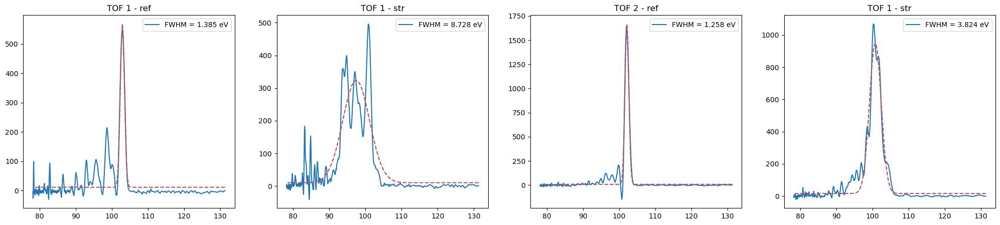

------------------------------------------------------------------------------
inlier index: 60


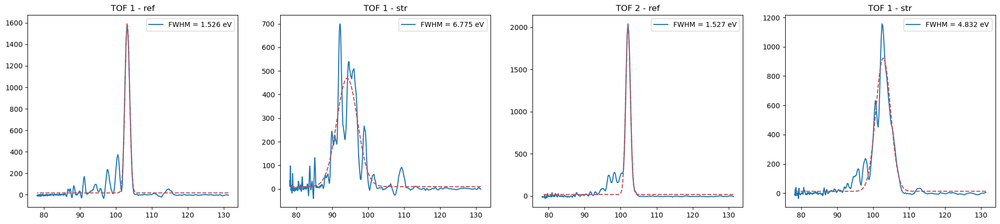

------------------------------------------------------------------------------
inlier index: 61


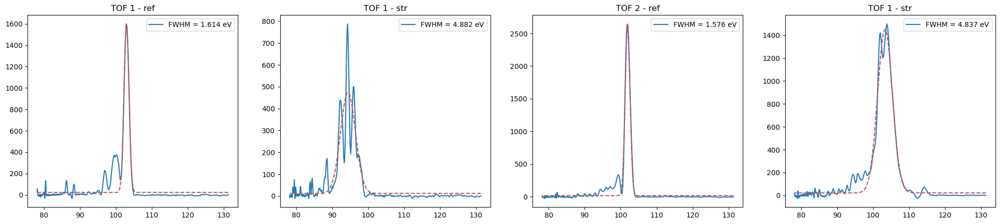

------------------------------------------------------------------------------
inlier index: 62


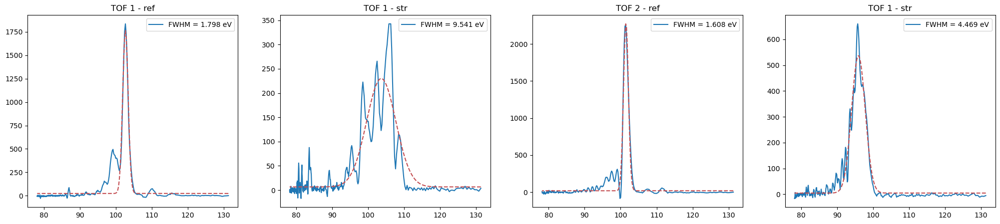

------------------------------------------------------------------------------
inlier index: 63


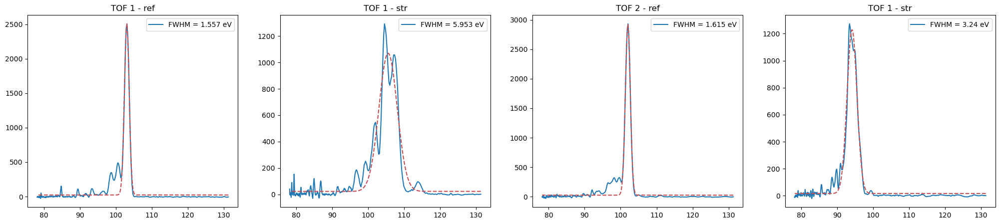

------------------------------------------------------------------------------
inlier index: 64


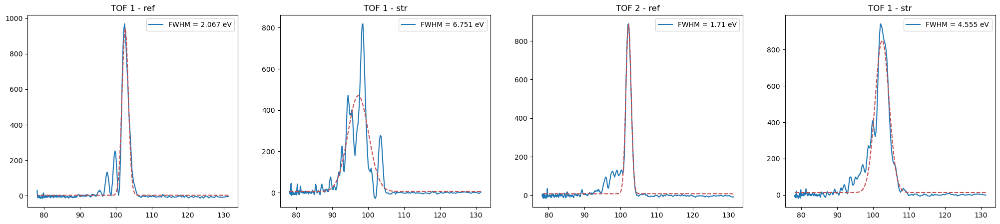

------------------------------------------------------------------------------
inlier index: 65


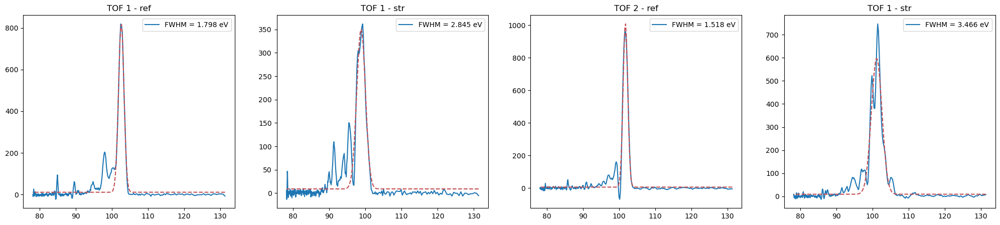

------------------------------------------------------------------------------
inlier index: 66


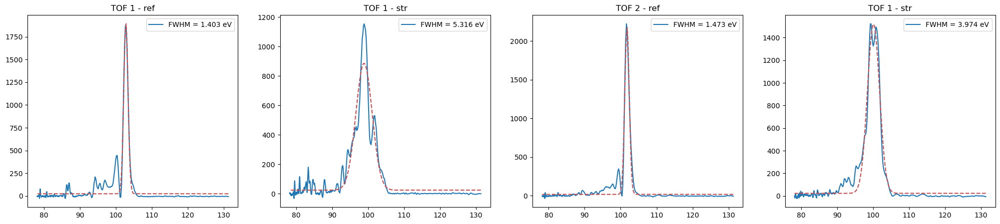

------------------------------------------------------------------------------
inlier index: 67


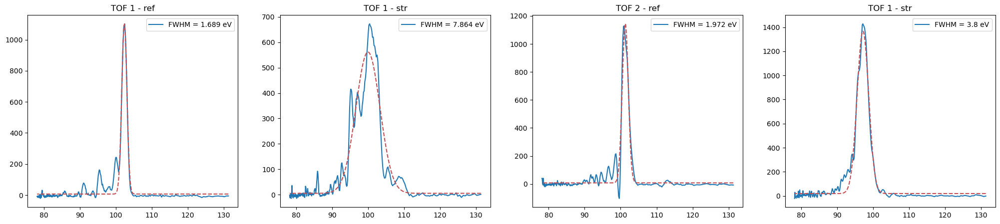

------------------------------------------------------------------------------
inlier index: 69


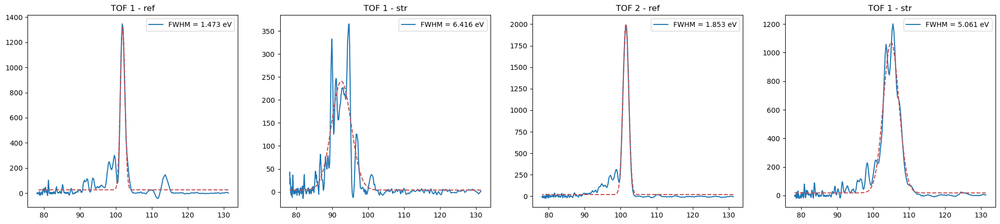

------------------------------------------------------------------------------
inlier index: 70


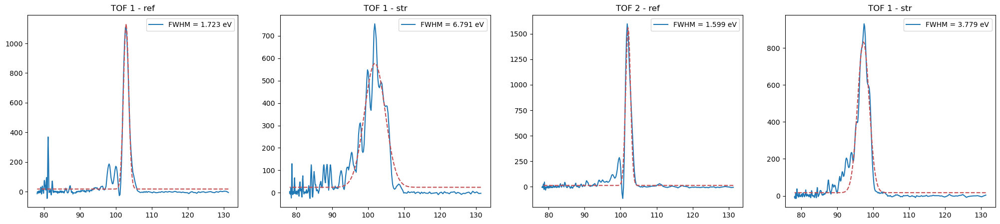

------------------------------------------------------------------------------
inlier index: 71


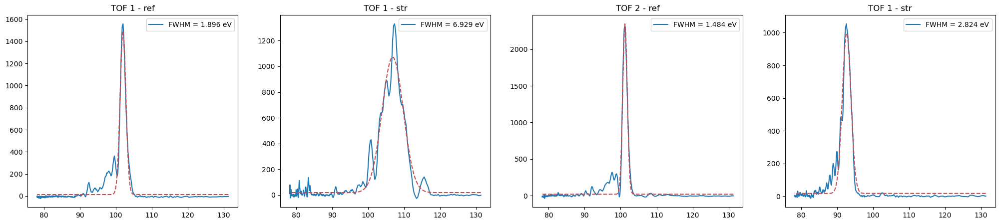

------------------------------------------------------------------------------
inlier index: 72


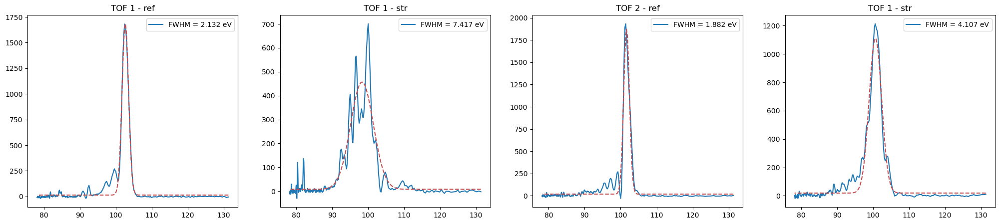

------------------------------------------------------------------------------
inlier index: 74


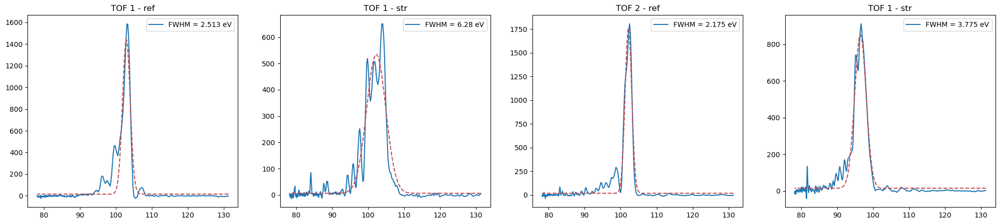

------------------------------------------------------------------------------
inlier index: 75


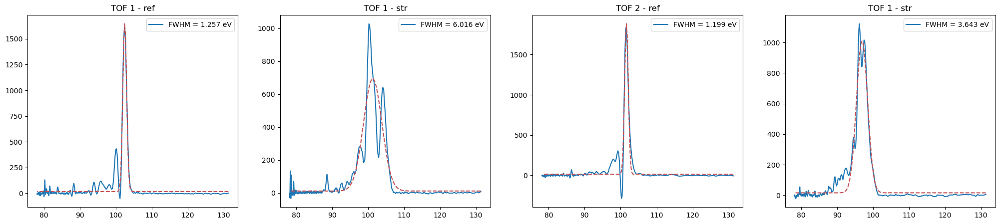

------------------------------------------------------------------------------
inlier index: 76


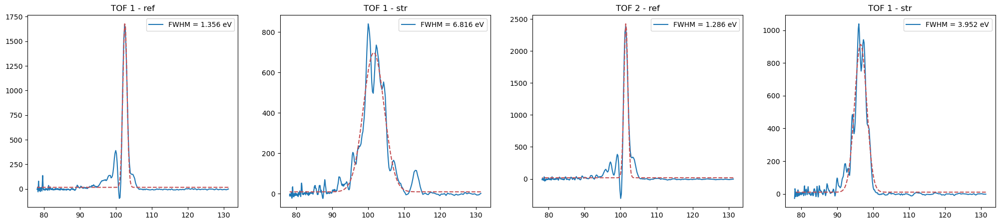

------------------------------------------------------------------------------
inlier index: 77


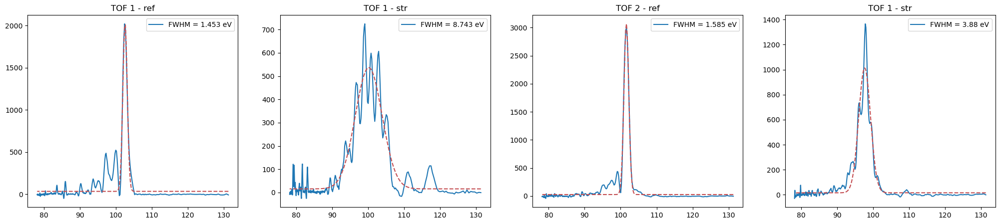

------------------------------------------------------------------------------
inlier index: 79


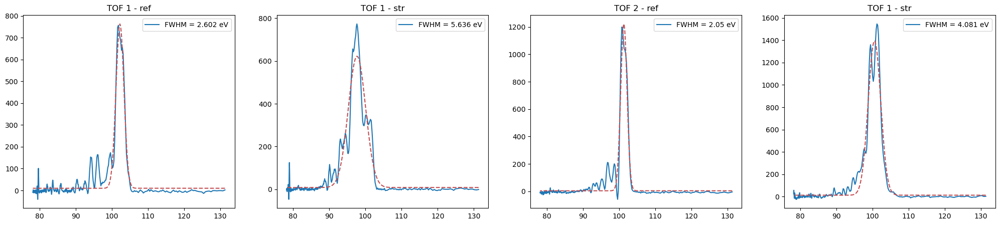

------------------------------------------------------------------------------
inlier index: 82


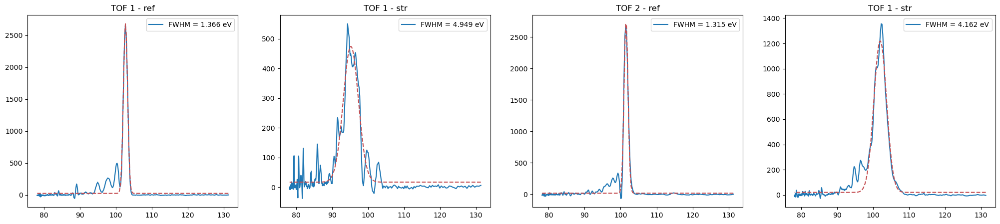

------------------------------------------------------------------------------
inlier index: 83


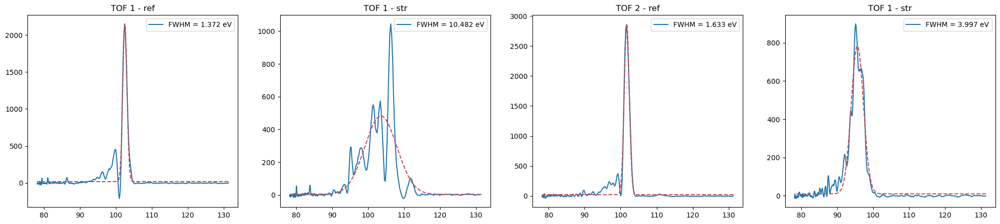

------------------------------------------------------------------------------
inlier index: 84


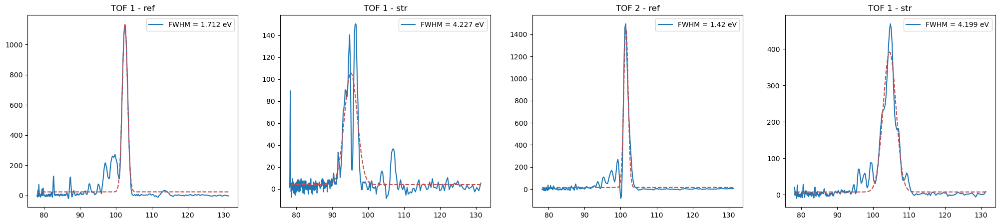

------------------------------------------------------------------------------
inlier index: 85


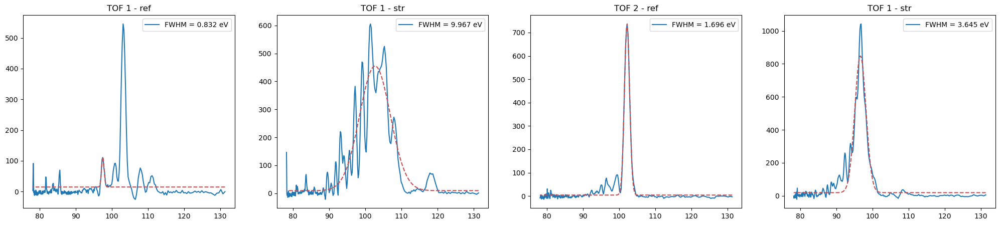

------------------------------------------------------------------------------
inlier index: 86


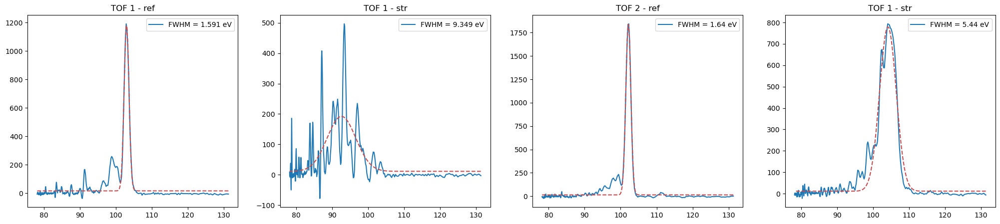

------------------------------------------------------------------------------
inlier index: 87


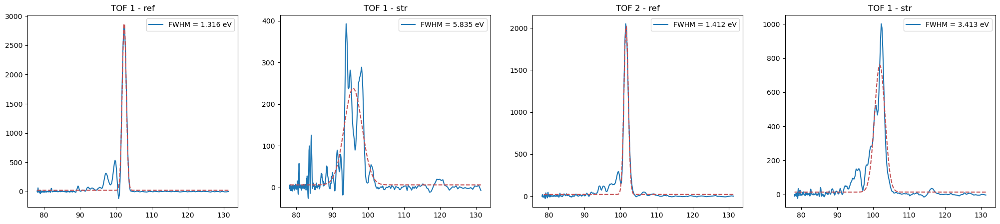

------------------------------------------------------------------------------
inlier index: 88


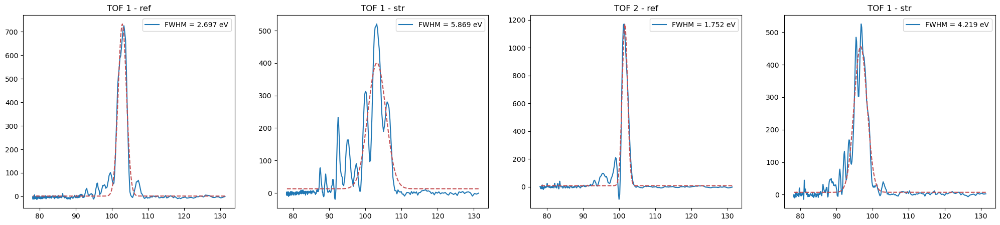

------------------------------------------------------------------------------
inlier index: 89


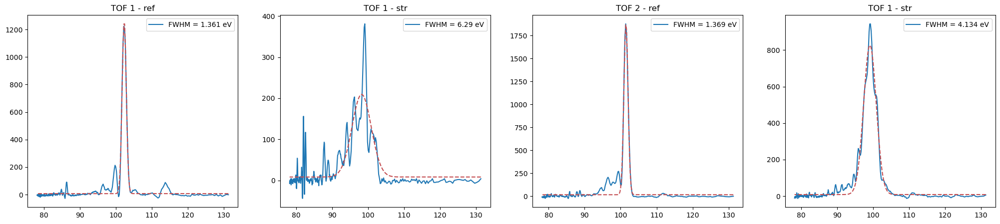

------------------------------------------------------------------------------
inlier index: 90


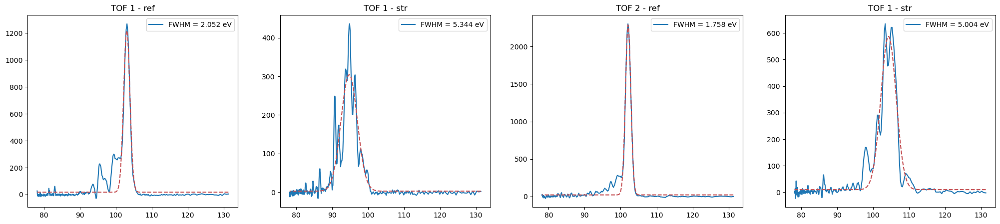

------------------------------------------------------------------------------
inlier index: 91


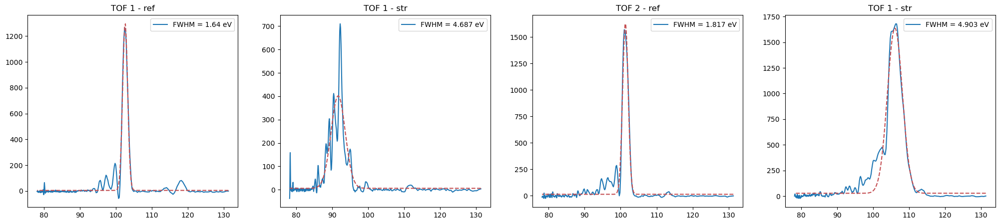

------------------------------------------------------------------------------
inlier index: 92


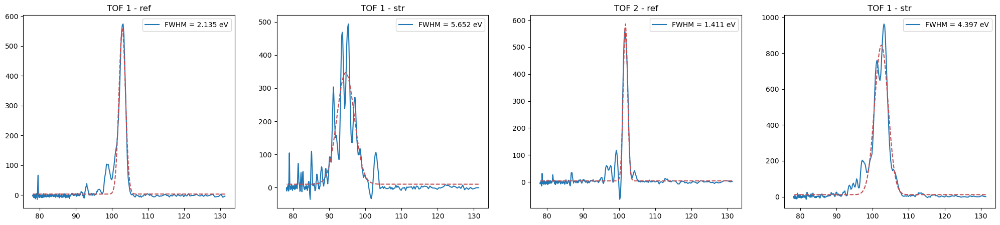

------------------------------------------------------------------------------
inlier index: 93


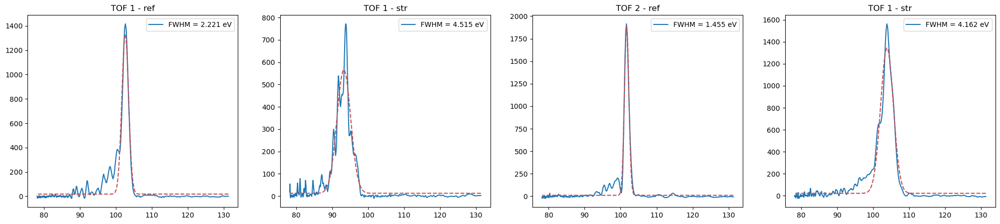

------------------------------------------------------------------------------
inlier index: 94


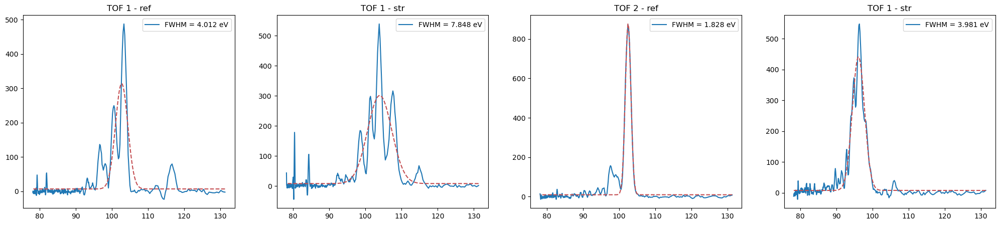

------------------------------------------------------------------------------
inlier index: 95


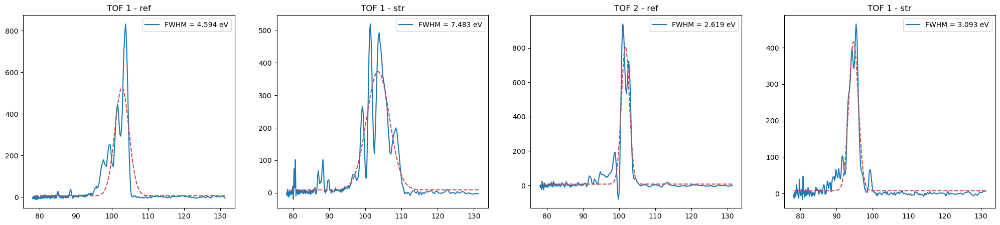

------------------------------------------------------------------------------
inlier index: 96


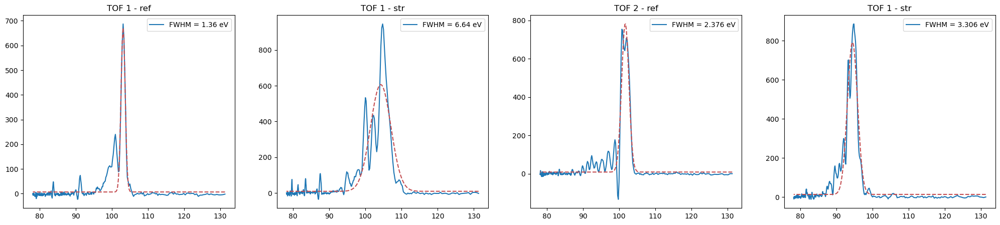

------------------------------------------------------------------------------
inlier index: 98


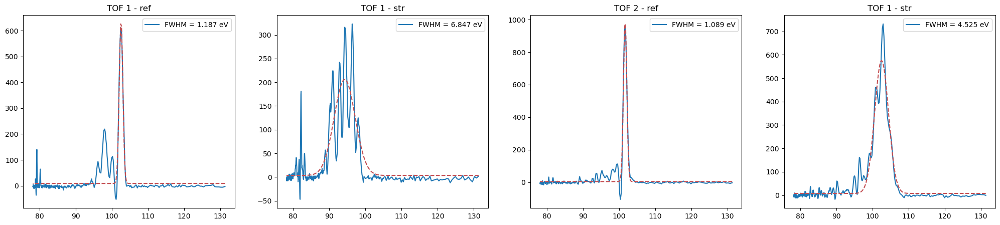

------------------------------------------------------------------------------
inlier index: 99


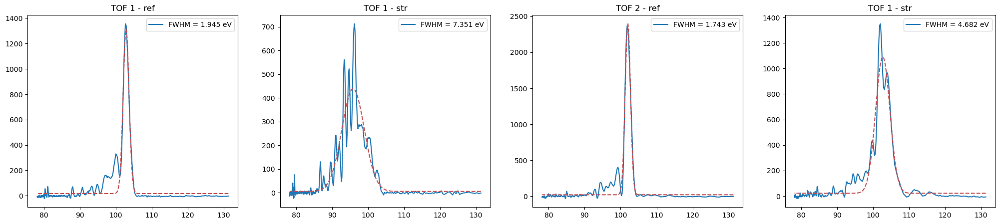

------------------------------------------------------------------------------
inlier index: 100


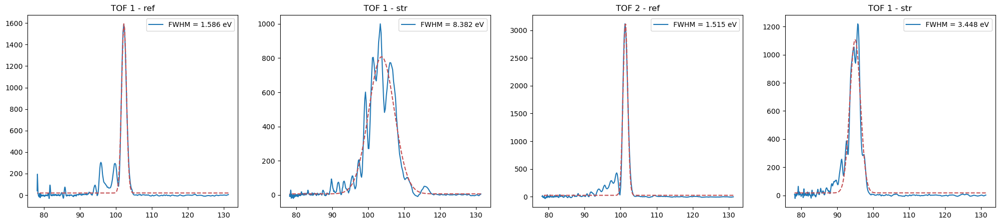

------------------------------------------------------------------------------
inlier index: 102


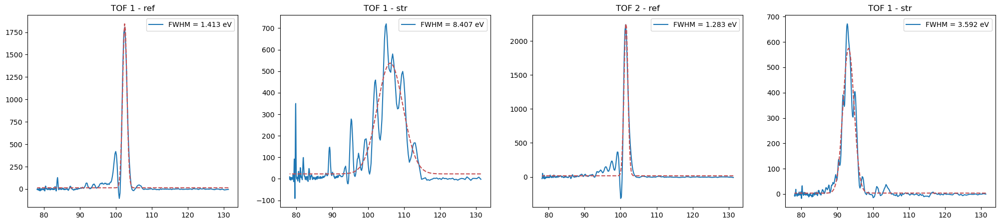

------------------------------------------------------------------------------
inlier index: 103


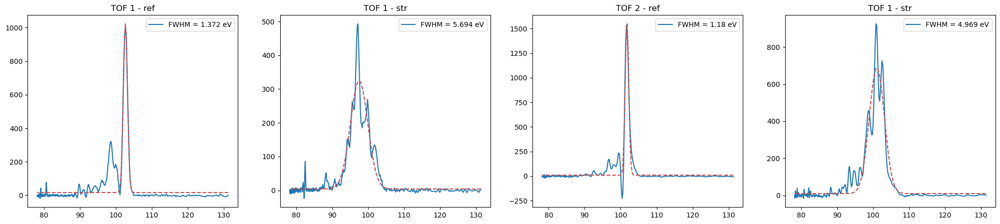

------------------------------------------------------------------------------
inlier index: 104


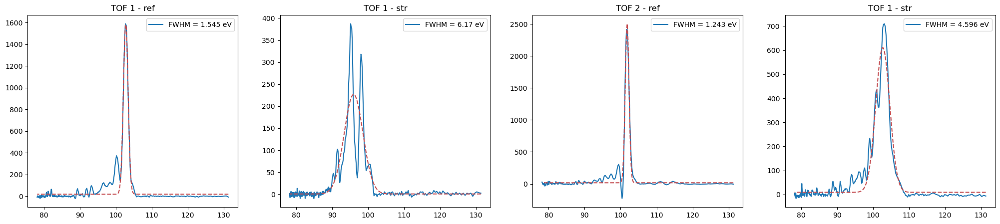

------------------------------------------------------------------------------
inlier index: 105


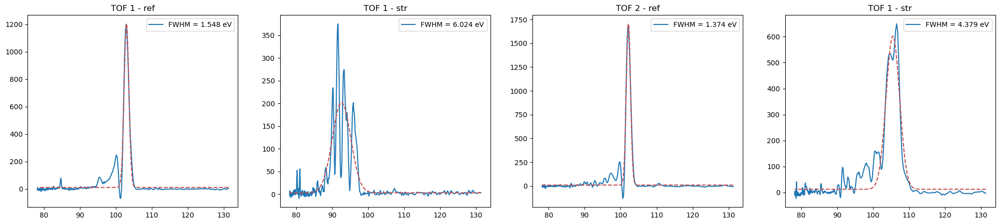

------------------------------------------------------------------------------
inlier index: 106


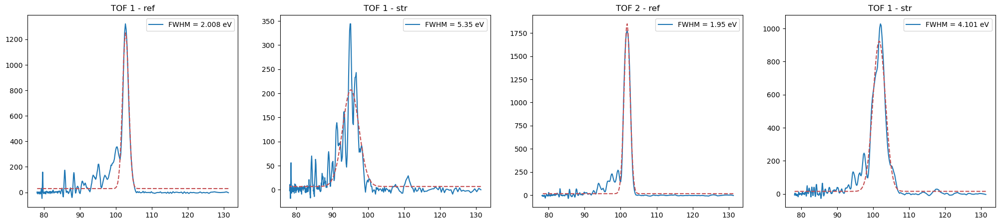

------------------------------------------------------------------------------
inlier index: 107


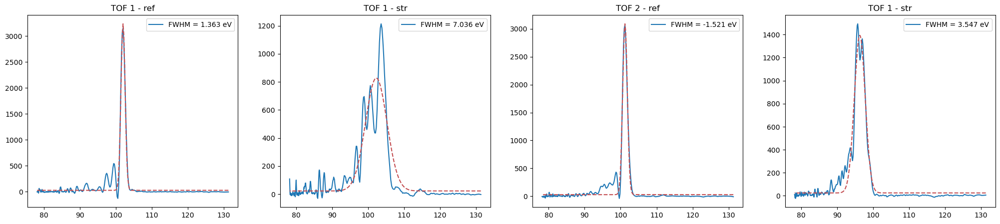

------------------------------------------------------------------------------
inlier index: 108


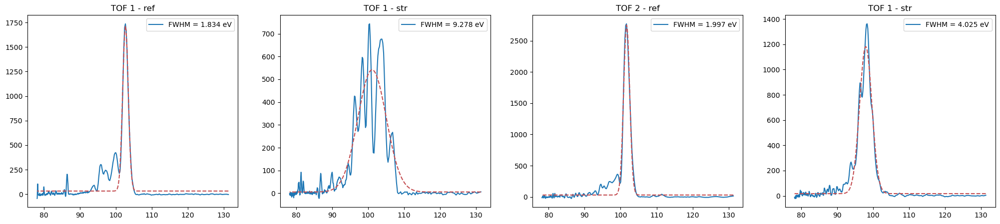

------------------------------------------------------------------------------
inlier index: 110


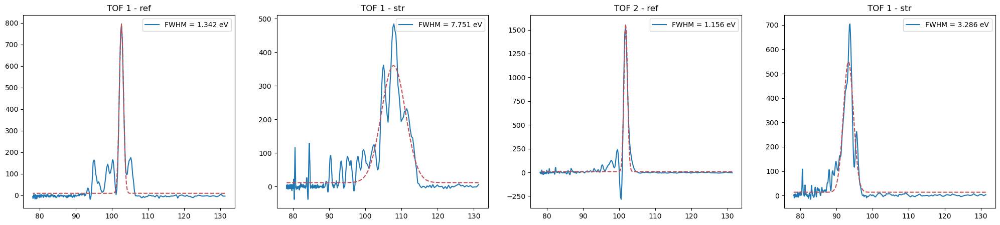

------------------------------------------------------------------------------
inlier index: 111


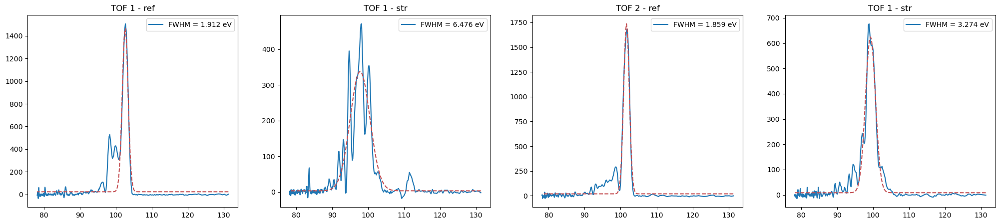

------------------------------------------------------------------------------
inlier index: 113


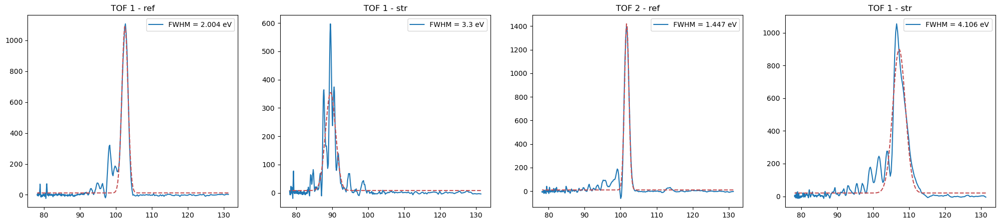

------------------------------------------------------------------------------
inlier index: 114


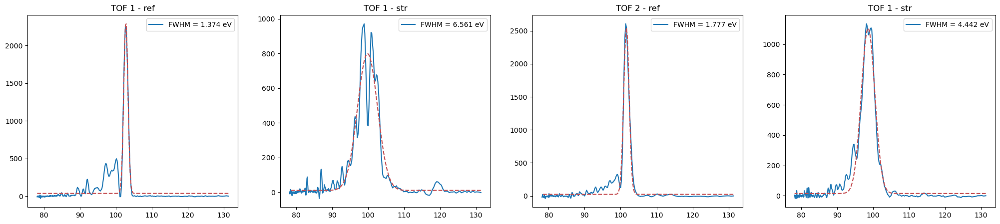

------------------------------------------------------------------------------
inlier index: 115


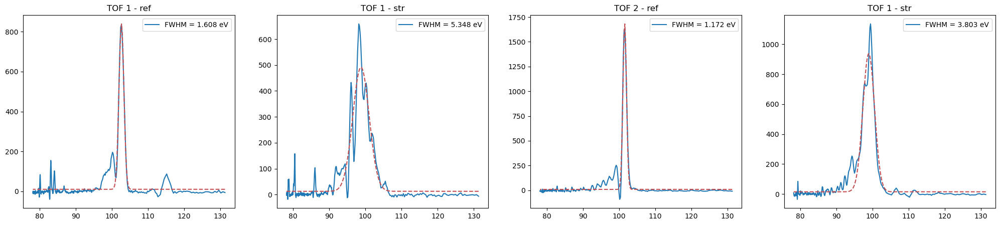

------------------------------------------------------------------------------
inlier index: 116


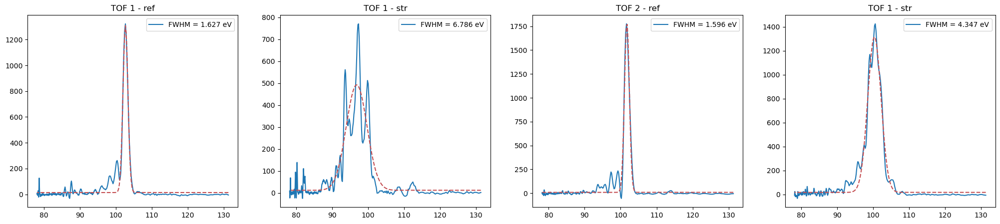

------------------------------------------------------------------------------
inlier index: 117


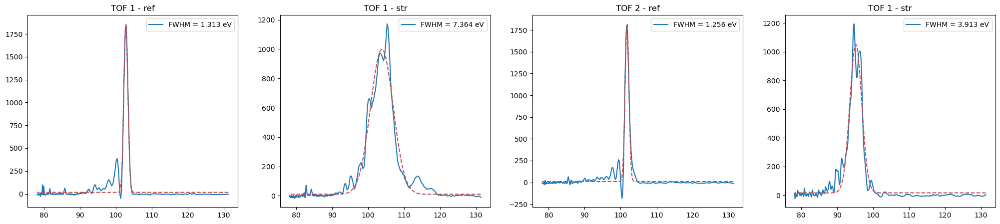

------------------------------------------------------------------------------
inlier index: 118


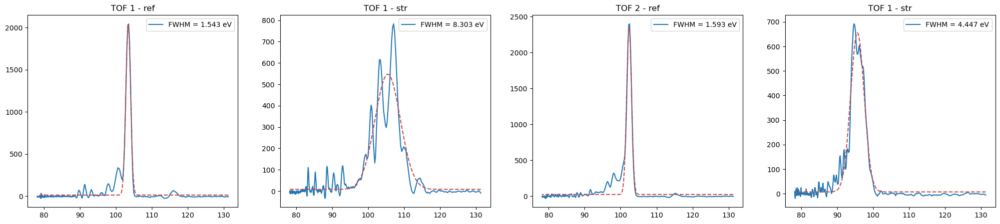

------------------------------------------------------------------------------
inlier index: 119


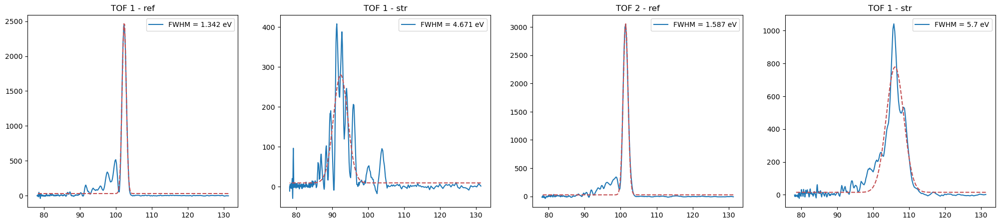

------------------------------------------------------------------------------
inlier index: 120


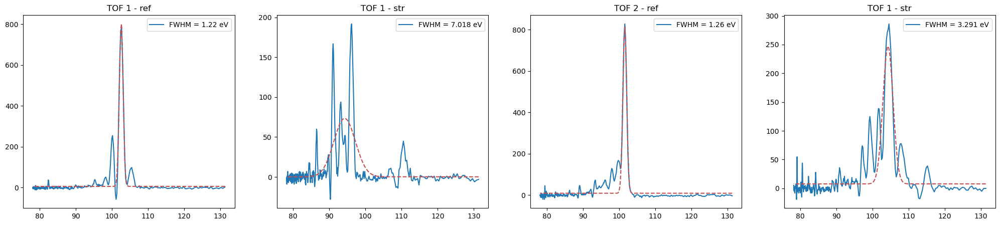

------------------------------------------------------------------------------
inlier index: 121


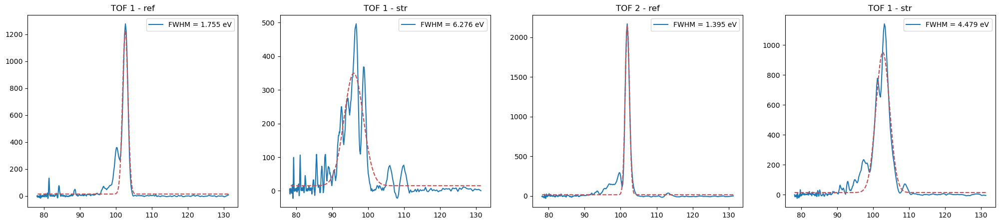

------------------------------------------------------------------------------
inlier index: 122


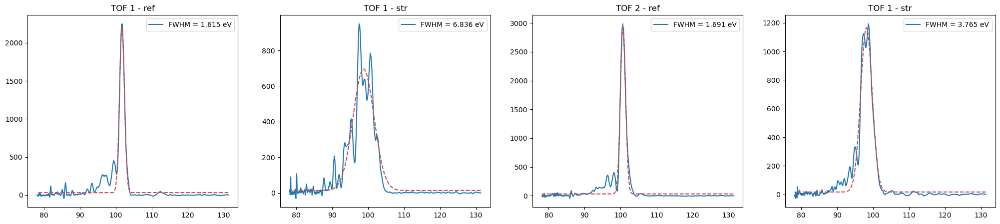

------------------------------------------------------------------------------
inlier index: 123


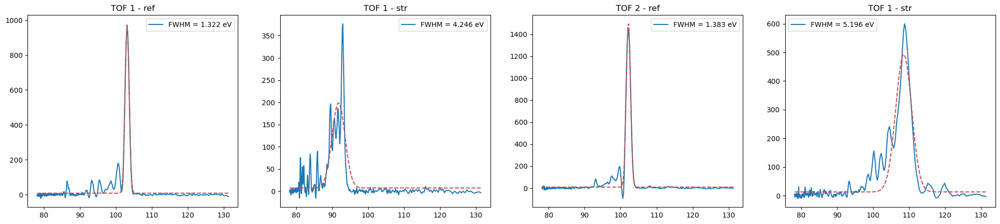

------------------------------------------------------------------------------
inlier index: 124


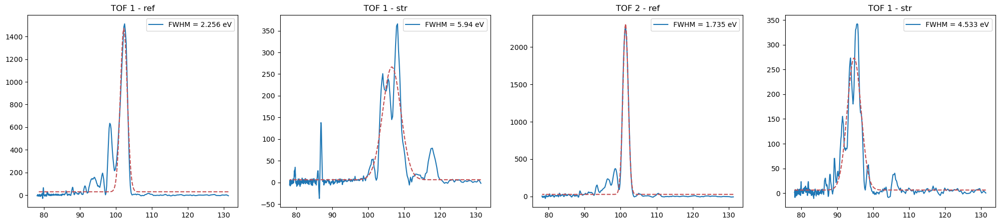

------------------------------------------------------------------------------
inlier index: 126


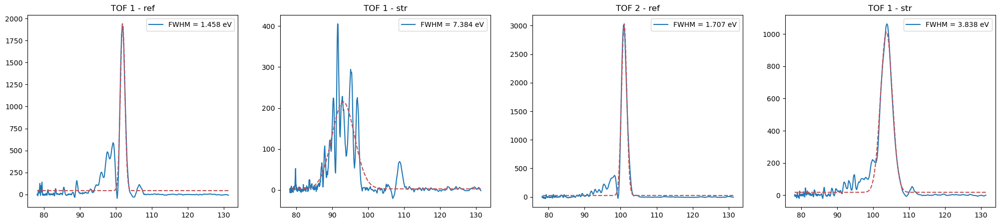

------------------------------------------------------------------------------
inlier index: 127


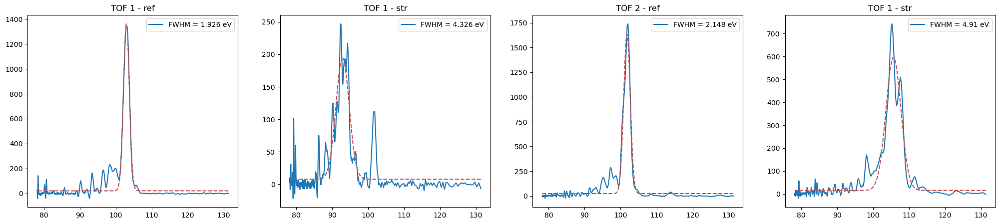

------------------------------------------------------------------------------
inlier index: 128


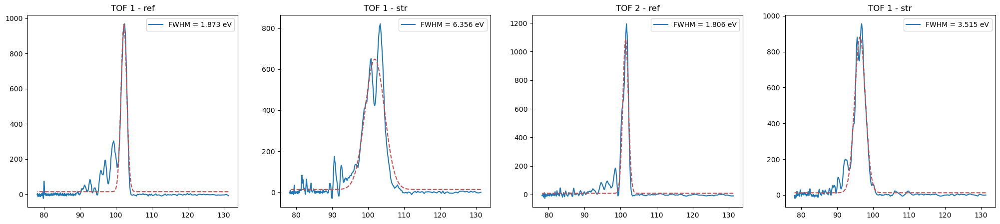

------------------------------------------------------------------------------
inlier index: 129


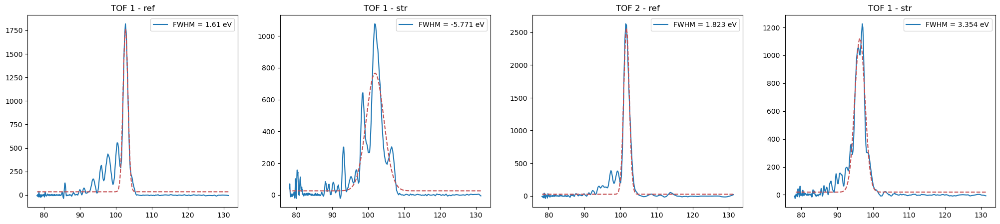

------------------------------------------------------------------------------
inlier index: 131


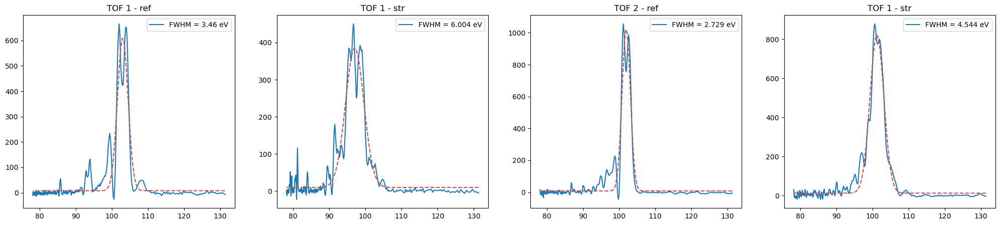

------------------------------------------------------------------------------
inlier index: 132


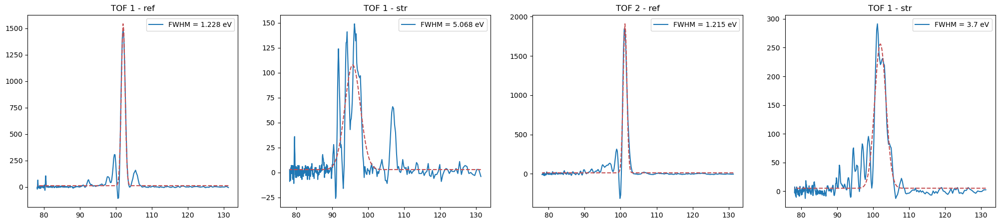

------------------------------------------------------------------------------
inlier index: 134


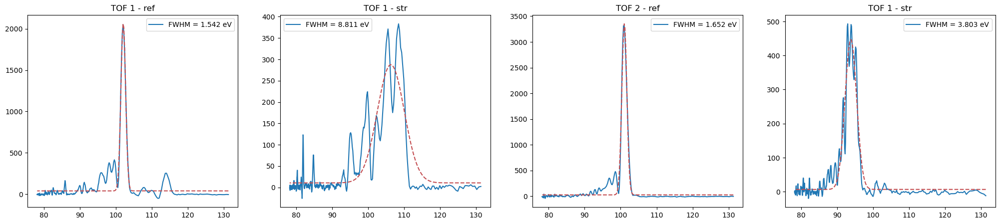

------------------------------------------------------------------------------
inlier index: 136


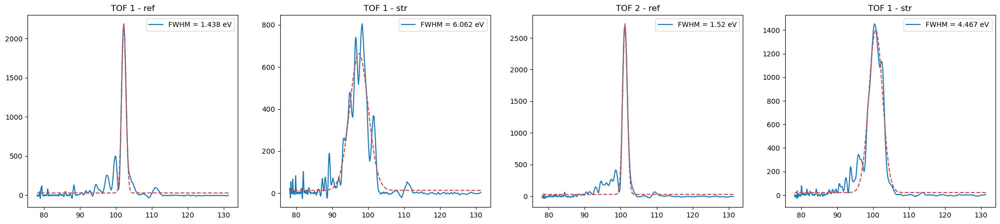

------------------------------------------------------------------------------
inlier index: 137


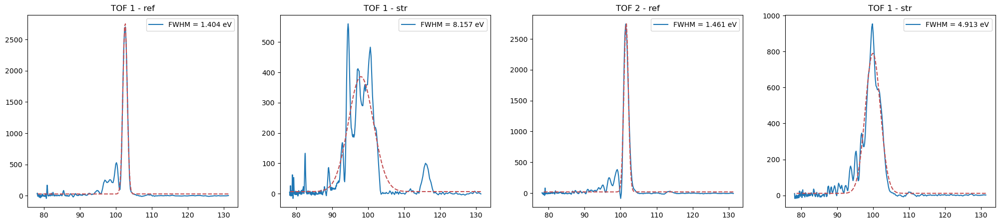

------------------------------------------------------------------------------
inlier index: 138


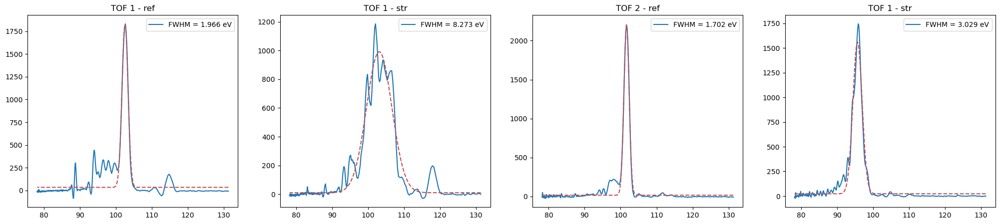

------------------------------------------------------------------------------
inlier index: 139


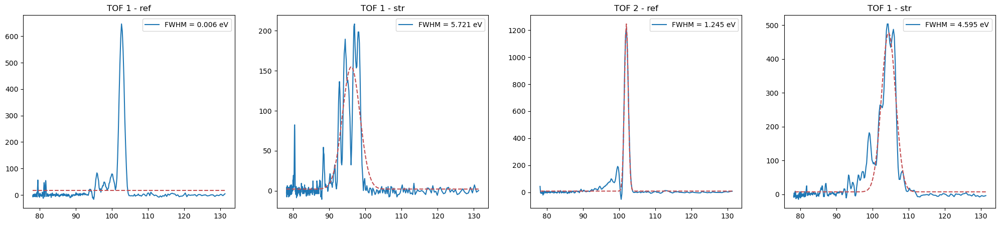

------------------------------------------------------------------------------
inlier index: 141


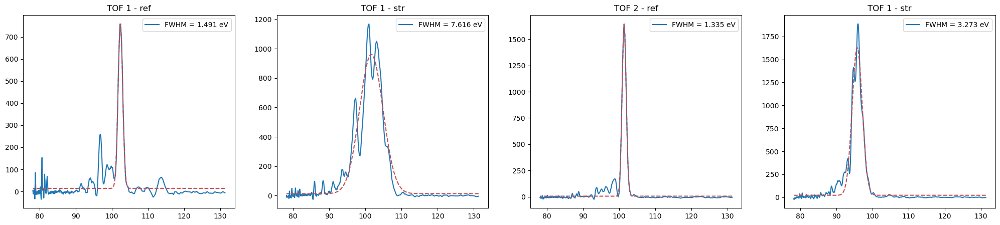

------------------------------------------------------------------------------
inlier index: 142


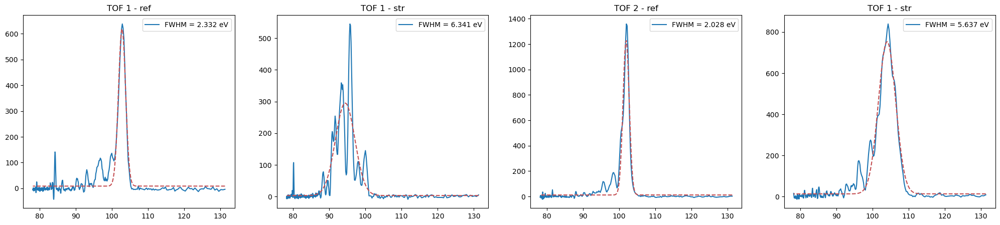

------------------------------------------------------------------------------
inlier index: 143


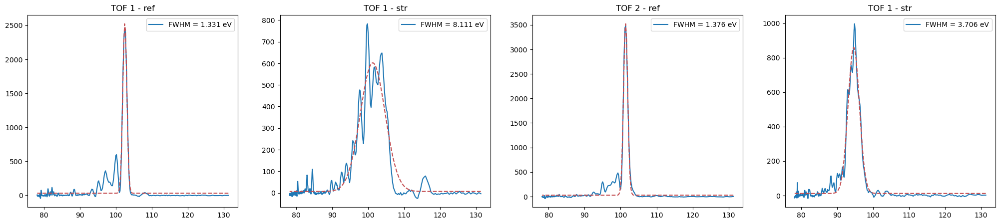

------------------------------------------------------------------------------
inlier index: 144


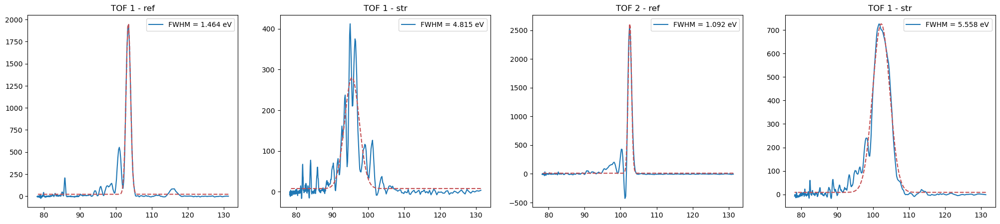

------------------------------------------------------------------------------
inlier index: 145


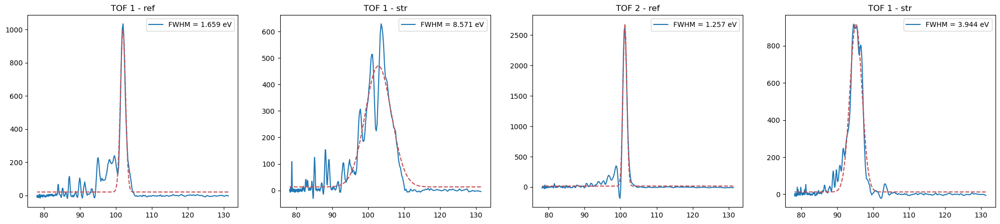

------------------------------------------------------------------------------
inlier index: 147


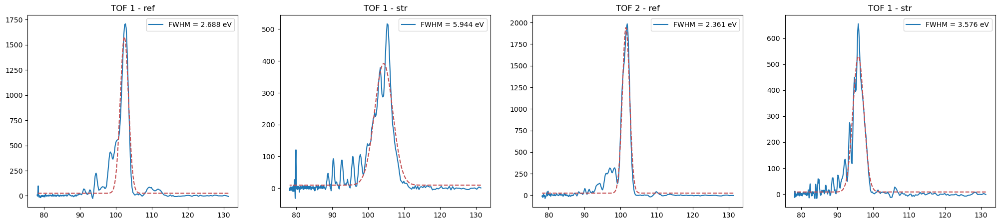

------------------------------------------------------------------------------
inlier index: 148


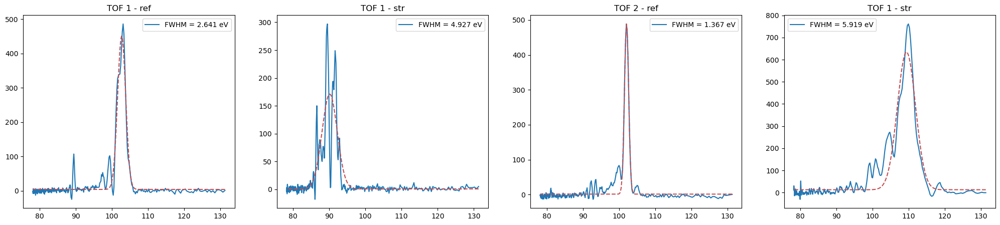

------------------------------------------------------------------------------
inlier index: 149


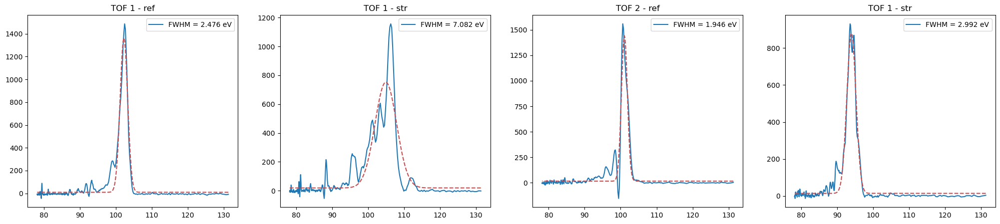

------------------------------------------------------------------------------
inlier index: 150


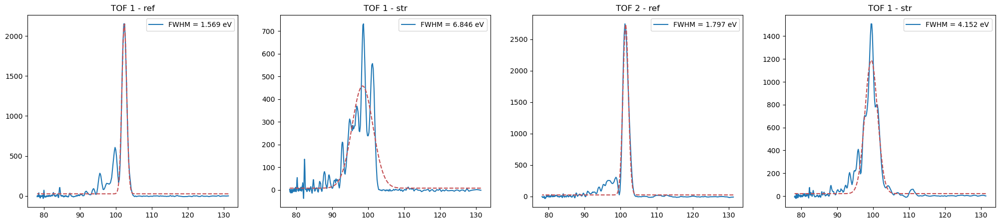

------------------------------------------------------------------------------
inlier index: 151


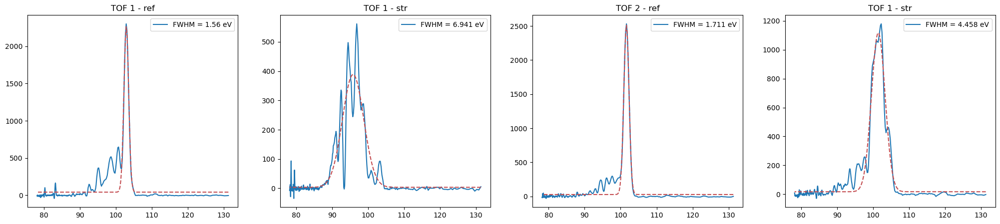

------------------------------------------------------------------------------
inlier index: 152


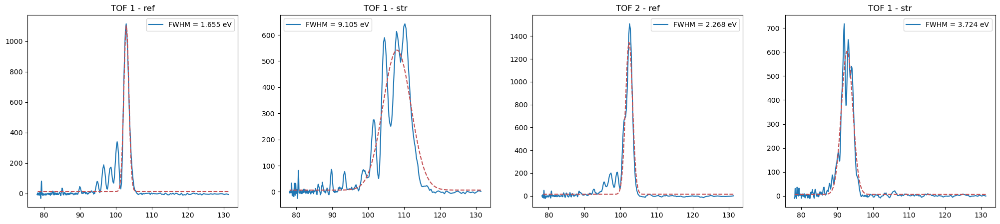

------------------------------------------------------------------------------
inlier index: 153


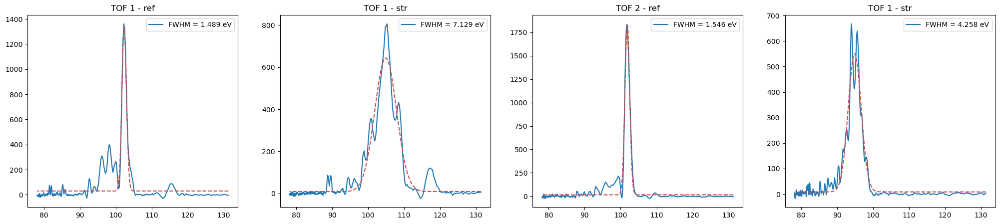

------------------------------------------------------------------------------
inlier index: 154


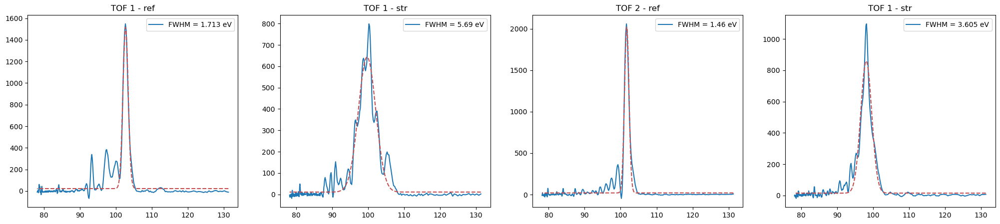

------------------------------------------------------------------------------
inlier index: 155


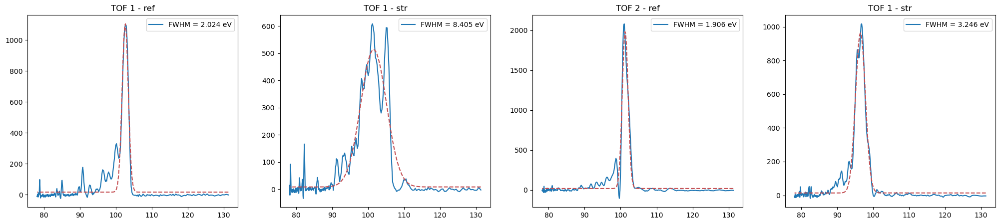

------------------------------------------------------------------------------
inlier index: 156


In [ ]:
plt.rcParams["figure.figsize"] = (25,5)

#len(reference_signal[1,:])
for l in range(0,len(reference_signal[1,:])):
    
    if inliers_index[l]>0:
        print("inlier index:",l)

        #TOF 1 ---------------------------------------
        plt.subplot(1, 4, 1)
        sfun.fitting_plotter(reference_signal,energy_axis,amp_ref1,mean_ref1,l,"TOF 1 - ref")
        plt.subplot(1, 4, 2)
        sfun.fitting_plotter(streaked_signal,energy_axis,amp_str1,mean_str1,l,"TOF 1 - str")
        #TOF 2 ---------------------------------------
        plt.subplot(1, 4, 3)
        sfun.fitting_plotter(reference_signal2,energy_axis2,amp_ref2,mean_ref2,l,"TOF 2 - ref")
        plt.subplot(1, 4, 4)
        sfun.fitting_plotter(streaked_signal2,energy_axis2,amp_str2,mean_str2,l,"TOF 1 - str")
        plt.show()
        print("------------------------------------------------------------------------------")

plt.rcParams["figure.figsize"] = (10,5)

### Traces
<a id="trace"></a>

In [ ]:
##### TOF1
sfun.trace_plotter(reference_signal,energy_axis,run_number,"TOF 1 reference signal")
sfun.trace_plotter(streaked_signal,energy_axis,run_number,"TOF 1 streaked signal")
##### TOF2
sfun.trace_plotter(reference_signal2,energy_axis2,run_number,"TOF 2 reference signal")
sfun.trace_plotter(streaked_signal2,energy_axis2,run_number,"TOF 2 streaked signal")